# **Informaciones**

**Trabajo personal, semana 6**

*Santiago Lamas Fresard*

# **Inicialización**

In [1]:
using Distributions, Gurobi, Ipopt, JuMP, LinearAlgebra, Measures, Plots, Random, Roots, SDDP

const GRB_ENV = Gurobi.Env()

Set parameter Username
Set parameter LicenseID to value 2760931
Academic license - for non-commercial use only - expires 2027-01-05


Gurobi.Env(Ptr{Nothing} @0x0000024255a6e810, false, 0)

# **Modelos**

*Single-species, multiaged forest model, taken from "A Discussion of Vintage Optimization Models in Forest Economics", A. Piazza, Forest Science, Vol 66(4) pp.469-477, 2020.*

## **Estimación de la función de costos**

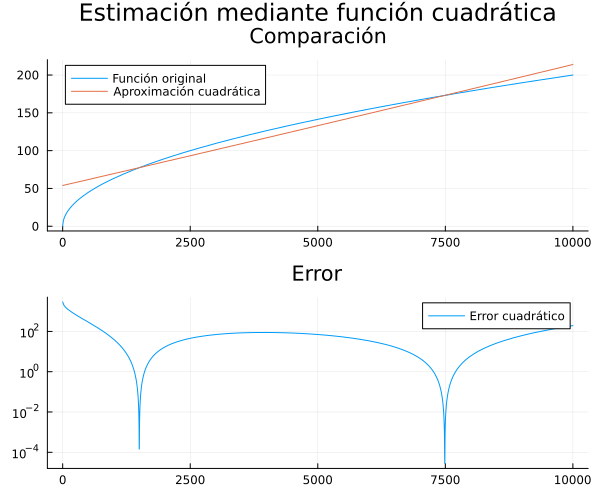

In [2]:
# Encuentra los parámetros que mejor aproximan la función x^(1-α)/(1-α) de acuerdo a la norma L^2([0,T])
function params_optimos(α, T)
    A = [T^5/5 T^4/4 T^3/3; T^4/4 T^3/3 T^2/2; T^3/3 T^2/2 T]
    b = [T^(4-α)/(4-α); T^(3-α)/(3-α); T^(2-α)/(2-α)]/(1-α)
    return A^-1*b
end

# Ejemplo: fijación de parámetros
α_ej, T_ej = 0.5, 10000
a_ej, b_ej, c_ej = params_optimos(α_ej, T_ej)

# Funciones a usar
quad_ej = x -> a_ej*x^2 + b_ej*x + c_ej
raiz_ej = x -> x^(1-α_ej)/((1-α_ej))
l2norm = x -> (quad_ej(x) - raiz_ej(x))^2

# Graficado
p1 = plot(raiz_ej, 0.01, T_ej, label="Función original")
plot!(quad_ej, 0.01, T_ej, label="Aproximación cuadrática", title="Comparación")
p2 = plot(l2norm, 0.01, T_ej, yaxis=:log10, label="Error cuadrático", title="Error")
plot(p1, p2, layout=(2,1), size=(600,500), plot_title="Estimación mediante función cuadrática")

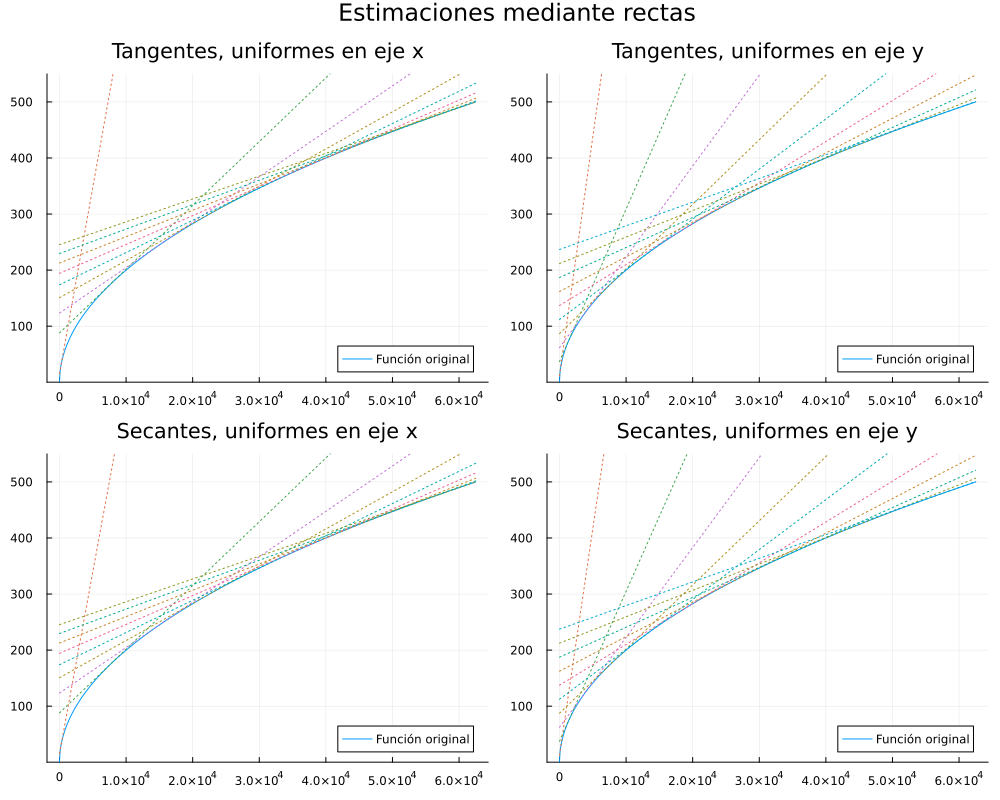

In [3]:
# Parámetros a usar en el problema
α = 0.5 # risk aversion parameter for the utility function
UB = 500 # upper bound for the objective function

# Funciones útiles
obj = x -> x^(1-α)/(1-α) # función objetivo
deriv_obj = x -> x^-α # derivada de función objetivo
inv_obj = y -> ((1-α)*y)^(1/(1-α)) # inversa de función objetivo

# Parámetros para estimar la función objetivo
T = inv_obj(UB)
nx, ny = 2500, 200 # número de puntos para discretizar 
dx, dy = T/nx, UB/ny # pasos para discretizar

# Aproximación por una función cuadrática
a, b, c = params_optimos(α, T)
approx_quad = x -> a*x^2 + b*x + c

# Discretización de los intervalos a trabajar
d_unif_x = 1:dx:T # uniforme en eje x
d_unif_y = 1:dy:UB          # uniforme en eje y

# Imagen y preimagen de las discretizaciones
f_unif_x = obj.(d_unif_x)    # uniforme en eje x
f_inv_y = inv_obj.(d_unif_y) # uniforme en eje y

# Aproximación mediante tangentes:
a_tgte_x = deriv_obj.(d_unif_x)             # pendiente uniforme en eje x
b_tgte_x = f_unif_x .- a_tgte_x .* d_unif_x # ordenada al origen uniforme en eje x
a_tgte_y = deriv_obj.(f_inv_y)              # pendiente uniforme en eje y
b_tgte_y = d_unif_y .- a_tgte_y .* f_inv_y  # ordenada al origen uniforme en eje y

# Aproximación mediante interpolación lineal:
a_interp_x = [(f_unif_x[i+1] - f_unif_x[i])/dx for i in 1:nx-1] # pendiente uniforme en eje x
b_interp_x = f_unif_x[1:nx-1] .- a_interp_x .* d_unif_x[1:nx-1] # ordenada al origen uniforme en eje x
a_interp_y = [dy/(f_inv_y[i+1] - f_inv_y[i]) for i in 1:ny-1]   # pendiente uniforme en eje y
b_interp_y = d_unif_y[1:ny-1] .- a_interp_y .* f_inv_y[1:ny-1]  # ordenada al origen uniforme en eje y

# Graficado
p1 = plot(obj, 0.1, T, ylims=(0.1,UB+50), label="Función original", title="Tangentes, uniformes en eje x")
for i in 10:300:nx
    plot!(x -> a_tgte_x[i]*x + b_tgte_x[i], label=false, linestyle=:dot)
end
p2 = plot(obj, 0.1, T, ylims=(0.1,UB+50), label="Función original", title="Tangentes, uniformes en eje y")
for i in 10:20:ny
    plot!(x -> a_tgte_y[i]*x + b_tgte_y[i], label=false, linestyle=:dot)
end
p3 = plot(obj, 0.1, T, ylims=(0.1,UB+50), label="Función original", title="Secantes, uniformes en eje x")
for i in 10:300:nx-1
    plot!(x -> a_interp_x[i]*x + b_interp_x[i], label=false, linestyle=:dot)
end
p4 = plot(obj, 0.1, T, ylims=(0.1,UB+50), label="Función original", title="Secantes, uniformes en eje y")
for i in 10:20:ny-1
    plot!(x -> a_interp_y[i]*x + b_interp_y[i], label=false, linestyle=:dot)
end
plot(p1, p2, p3, p4, layout=(2,2), size=(1000,800), plot_title="Estimaciones mediante rectas")

## **Prueba de modelos**

### **Fijación de parámetros**

In [4]:
UB = 5000 # upper bound for the objective function
b = 0.975 # discount factor used by Buongiorno
α = 0.5 # risk aversion parameter for the utility function
n = 5 # number of age classes
f = [0.8, 4.2, 16.99, 68.1, 84] # biomass coeffcients
x0 = [1.0, 0.0, 0.0, 0.0, 0.0] # initial state

# Creamos un gráfico cíclico de un nodo con probablidad (1-b) de salir del ciclo 
# graph = SDDP.LinearGraph(400)

graph = SDDP.UnicyclicGraph(b; num_nodes = 1)

# Número de iteraciones para entrenar y simulaciones
n_train_iterations = 50
n_simulations = 2000

2000

### **Función cuadrática**

In [5]:
model0 = SDDP.PolicyGraph(
    graph;
    # maximizamos función de retorno
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:n] >=0, SDDP.State, initial_value = x0[s]) # state variables, multidimensional. Time to figure this out: 3 hours!!!!
    @variable(sp, c[1:n] >= 0) # control variables
    @variable(sp, TV >= 0) # Timber volume
    @constraints(sp, begin
        c[n] == x[n].in # we harvest everything for the oldest age class
        [s = 1:n-1], x[s+1].out == x[s].in - c[s] # balance equations
        sum(f[s] * c[s] for s in 1:n) == TV # timber volume
        [s = 1:n], x[s].out <= 1 # state space constraints
        sum(x[s].out for s in 1:n) == 1 # x[1].out will be determined by this equation because the other x[s].out are determined by the balance equations
    end)
    @stageobjective(sp, approx_quad(TV))
end

println("Aproximación cuadrática:")
SDDP.numerical_stability_report(model0)

SDDP.train(model0, iteration_limit = n_train_iterations)
# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model0, n_simulations, [:x])
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model0)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

Aproximación cuadrática:
numerical stability report
  matrix range     [8e-01, 8e+01]
  objective range  [0e+00, 0e+00]
  bounds range     [5e+03, 5e+03]
  rhs range        [1e+00, 1e+00]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 5
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [17, 17]
  AffExpr in MOI.EqualTo{Float64}         : [7, 7]
  AffExpr in MOI.LessThan{Float64}        : [5, 5]
  VariableRef in MOI.GreaterThan{Float64} : [11, 11]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [8e-01, 8e+01]
  objective range  [0e+00, 0e+00]
  bounds range  

### **Tangente uniforme en x**

In [6]:
model1 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:n] >=0, SDDP.State, initial_value = x0[s]) # state variables, multidimensional.
    @variable(sp, c[1:n] >= 0) # control variables
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        c[n] == x[n].in # we harvest everything for the oldest age class
        [s = 1:n-1], x[s+1].out == x[s].in - c[s] # balance equations
        sum(f[s] * c[s] for s in 1:n) == TV # timber volume
        [s = 1:n], x[s].out <= 1 # state space constraints
        sum(x[s].out for s in 1:n) == 1 # x[1].out will be determined by this equation because the other x[s].out are determined by the balance equations
        [s = 1:nx], u <= a_tgte_x[s]*TV + b_tgte_x[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

println("Aproximación tangencial uniforme en x:")
SDDP.numerical_stability_report(model1)

SDDP.train(model1, iteration_limit = n_train_iterations)
# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model1, n_simulations, [:x])
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model1)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

Aproximación tangencial uniforme en x:
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [5e+03, 5e+03]
  rhs range        [1e+00, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 5
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [18, 18]
  AffExpr in MOI.EqualTo{Float64}         : [7, 7]
  AffExpr in MOI.LessThan{Float64}        : [2505, 2505]
  VariableRef in MOI.GreaterThan{Float64} : [12, 12]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+

### **Tangente uniforme en y**

In [7]:
model2 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:n] >=0, SDDP.State, initial_value = x0[s]) # state variables, multidimensional. Time to figure this out: 3 hours!!!!
    @variable(sp, c[1:n] >= 0) # control variables
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        c[n] == x[n].in # we harvest everything for the oldest age class
        [s = 1:n-1], x[s+1].out == x[s].in - c[s] # balance equations
        sum(f[s] * c[s] for s in 1:n) == TV # timber volume
        [s = 1:n], x[s].out <= 1 # state space constraints
        sum(x[s].out for s in 1:n) == 1 # x[1].out will be determined by this equation because the other x[s].out are determined by the balance equations
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

println("Aproximación tangencial uniforme en y:")
SDDP.numerical_stability_report(model2)

SDDP.train(model2, iteration_limit = n_train_iterations)
# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model2, n_simulations, [:x])
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model2)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

Aproximación tangencial uniforme en y:
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [5e+03, 5e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 5
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [18, 18]
  AffExpr in MOI.EqualTo{Float64}         : [7, 7]
  AffExpr in MOI.LessThan{Float64}        : [205, 205]
  VariableRef in MOI.GreaterThan{Float64} : [12, 12]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00

### **Secante uniforme en x**

In [8]:
model3 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:n] >=0, SDDP.State, initial_value = x0[s]) # state variables, multidimensional. Time to figure this out: 3 hours!!!!
    @variable(sp, c[1:n] >= 0) # control variables
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        c[n] == x[n].in # we harvest everything for the oldest age class
        [s = 1:n-1], x[s+1].out == x[s].in - c[s] # balance equations
        sum(f[s] * c[s] for s in 1:n) == TV # timber volume
        [s = 1:n], x[s].out <= 1 # state space constraints
        sum(x[s].out for s in 1:n) == 1 # x[1].out will be determined by this equation because the other x[s].out are determined by the balance equations
        [s = 1: nx-1], u <= a_interp_x[s]*TV + b_interp_x[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

println("Aproximación interpolando uniforme en x:")
SDDP.numerical_stability_report(model3)

SDDP.train(model3, iteration_limit = n_train_iterations)
# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model3, n_simulations, [:x])
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model3)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

Aproximación interpolando uniforme en x:
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [5e+03, 5e+03]
  rhs range        [1e+00, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 5
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [18, 18]
  AffExpr in MOI.EqualTo{Float64}         : [7, 7]
  AffExpr in MOI.LessThan{Float64}        : [2504, 2504]
  VariableRef in MOI.GreaterThan{Float64} : [12, 12]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1

### **Secante uniforme en y**

In [9]:
model4 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:n] >=0, SDDP.State, initial_value = x0[s]) # state variables, multidimensional. Time to figure this out: 3 hours!!!!
    @variable(sp, c[1:n] >= 0) # control variables
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        c[n] == x[n].in # we harvest everything for the oldest age class
        [s = 1:n-1], x[s+1].out == x[s].in - c[s] # balance equations
        sum(f[s] * c[s] for s in 1:n) == TV # timber volume
        [s = 1:n], x[s].out <= 1 # state space constraints
        sum(x[s].out for s in 1:n) == 1 # x[1].out will be determined by this equation because the other x[s].out are determined by the balance equations
        [s = 1: ny-1], u <= a_interp_y[s]*TV + b_interp_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

println("Aproximación interpolando uniforme en y:")
SDDP.numerical_stability_report(model4)

SDDP.train(model4, iteration_limit = n_train_iterations)
# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model4, n_simulations, [:x])
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model4)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

Aproximación interpolando uniforme en y:
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [5e+03, 5e+03]
  rhs range        [8e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 5
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [18, 18]
  AffExpr in MOI.EqualTo{Float64}         : [7, 7]
  AffExpr in MOI.LessThan{Float64}        : [204, 204]
  VariableRef in MOI.GreaterThan{Float64} : [12, 12]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+

# **Simulaciones**

## **Euler-Maruyama**

In [10]:
# Constants and matrices
α_d, β_d      = 35.3462, 0.0280        # fixed-effects diameter intercept & pull-back (Table 2 in the paper)
α_h, β_h      = 25.3301, 0.0396        # fixed-effects height intercept & pull-back (Table 2 in the paper)
σ11, σ12, σ22 = 2.3736, 0.6334, 0.3615  # mixed-effects diffusion entries (PD!). For the fixed ones,the matrix is singular
mu = [α_d, α_h] 
gamma = Diagonal([β_d, β_h])
B = [σ11 σ12; σ12 σ22]


2×2 Matrix{Float64}:
 2.3736  0.6334
 0.6334  0.3615

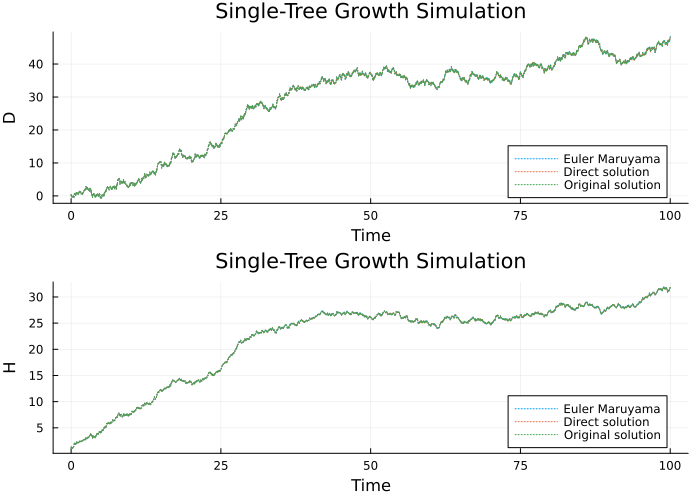

In [11]:
# Basic simulation info
T       = 100 # time horizon
n       = 5000 # number of steps
Δt      = T/n # time step
x0      = [0.1, 1.3]  # start (diameter, height) at t0
sqB     = sqrt(B) # matrix B^1/2

# Allocate & initialize
EM = Array{Float64}(undef, 2, n+1) # Euler-Maruyama scheme
EM[:,1] .= x0
DS = Array{Float64}(undef, 2, n+1) # direct solution
DS[:,1] .= x0
OS = Array{Float64}(undef, 2, n+1) # original scheme
OS[:,1] .= x0
BI = [0, 0] # brownian integral

# Useful matrices
F = exp(-gamma * Δt)
Q = [ σ11*(1-exp(-2β_d*Δt))/(2β_d)     σ12*(1-exp(-(β_d+β_h)*Δt))/(β_d+β_h);
      σ12*(1-exp(-(β_d+β_h)*Δt))/(β_d+β_h)   σ22*(1-exp(-2β_h*Δt))/(2β_h) ]
I2 = Matrix{Float64}(I, 2, 2)

# Simulate forward from k=1..n between Euler-Maruyama, the direct solution and the original simulations
rng = MersenneTwister(39) # fix random seed
dist = MvNormal(zeros(2), Δt*I2)
for k in 1:n
    η = rand(rng, dist)
    EM[:,k+1] = EM[:,k] + gamma*(mu - EM[:,k])*Δt .+ sqB * η
    BI += exp(gamma*Δt*(k-1)) * sqB * η
    DS[:,k+1] = mu .+ exp(-gamma*Δt*k)*(x0 .- mu .+ BI)
    OS[:,k+1] = mu .+ F*(OS[:,k] - mu) .+ sqrt(Q/Δt)*η
end

# Plot the single trajectory

t = 0:Δt:T
p1 = plot(t, EM[1,:], label="Euler Maruyama", xlabel="Time", ylabel="D", legend=:bottomright, linestyle=:dot)
plot!(t, DS[1,:], label="Direct solution", xlabel="Time", ylabel="D", legend=:bottomright, linestyle=:dot)
plot!(t, OS[1,:], label="Original solution", xlabel="Time", ylabel="D", legend=:bottomright, linestyle=:dot)
p2 = plot(t, EM[2,:], label="Euler Maruyama", xlabel="Time", ylabel="H", legend=:bottomright, linestyle=:dot)
plot!(t, DS[2,:], label="Direct solution", xlabel="Time", ylabel="H", legend=:bottomright, linestyle=:dot)
plot!(t, OS[2,:], label="Original solution", xlabel="Time", ylabel="H", legend=:bottomright, linestyle=:dot)
plot(p1, p2, layout=(2,1), size=(700,500), title="Single‐Tree Growth Simulation")

## **Markovianización**

Se toma la siguiente simplificación del modelo: Cada 5 años, se clasifican el diámetro y la altura de cada árbol según clases de los siguientes rangos: 5 cm para el diámetro y 5 m para la altura. Se omite la posibilidad de tomar valores negativos (factible según el modelo)

In [12]:
mc = Dict()
mc_sum = Dict()
mc_norm = Dict()
valid_idx = []

io = open("markovian.txt", "r")
for line in eachline(io)
  str_d1, str_h1, str_d2, str_h2, str_val = line[2], line[5], line[8], line[11], line[13:end]
  pd1, ph1, pd2, ph2 = parse(Int64, str_d1), parse(Int64, str_h1), parse(Int64, str_d2), parse(Int64, str_h2)
  val = parse(Float64, str_val)
  mc[[pd1, ph1], [pd2, ph2]] = val
  if !([pd1, ph1] in valid_idx)
      push!(valid_idx, [pd1, ph1])
  end
end

io_sum = open("markovian_sum.txt", "r")
for line in eachline(io_sum)
  str_d, str_h, str_val = line[2], line[5], line[7:end]
  pd, ph = parse(Int64, str_d), parse(Int64, str_h)
  val = parse(Float64, str_val)
  mc_sum[[pd, ph]] = val
end

for ik in valid_idx
    s = mc_sum[ik]
    for jl in valid_idx
        mc_norm[ik,jl] = mc[ik,jl]/s
    end
end

# **Extensión del modelo Markovianizado**

## **Creación del modelo**

In [13]:
N = length(valid_idx)

x0_test = zeros(N)
x0_test[1] = 1
f_test = Float64[]
BAs = Float64[]
rel = Dict()
for i in 1:N
    push!(f_test, 1)
    i_d, i_h = valid_idx[i]
    rel[i] = [i_d, i_h]
    d_i = 5*i_d + 2.5
    push!(BAs, pi*d_i^2/40000) 
end

tr_mtx = zeros(N,N)
tr_mtx_norm = zeros(N,N)
for i in 1:N
    for j in 1:N
        tr_mtx[i,j] = mc[(rel[i],rel[j])]
        tr_mtx_norm[i,j] = mc_norm[(rel[i],rel[j])]
    end
end

# **Modelo con regeneración**

El modelo de regeneración a usar corresponde a aquel trabajado en Bollandsas et al, en el cual en cada etapa, el número de árboles de la especie $i\in\{1,\ldots, N\}$ de la primera clase de altura y diámetro corresponde al producto $\pi_i \times CR_i$, con 
- $\pi_i = \frac{e^{\alpha_{i0} + \alpha_{i1} BA + \alpha_{i2} SI + \alpha_{i3} PBA}}{1 + e^{\alpha_{i0} + \alpha_{i1} BA + \alpha_{i2} SI + \alpha_{i3} PBA}}$
- $CR_i = \beta_{i0} BA^{\beta_{i1}} SI^{\beta_{i2}} PBA^{\beta_{i3}}$

En particular, se asume que el área en la cual se trabaja es exactamente una hectárea, el site index SI corresponde a la altura promedio de los árboles dominantes de 40 años y el PBA es idéntico a 1 al existir una única especie.

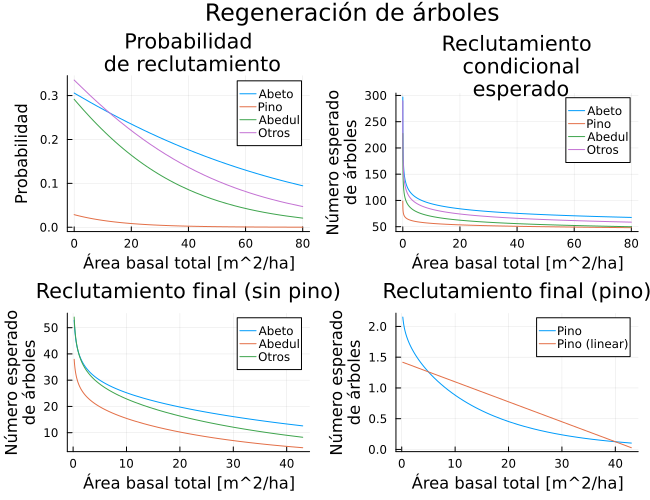

In [14]:
SI = 22 # testing

# Probabilidades de regeneración
coefs_p_abeto = [-2.291, -0.018, 0.066, 0.019]
coefs_p_pino = [-3.552, -0.062, 0, 0.031]
coefs_p_abedul = [-0.904, -0.037, 0, 0.016]
coefs_p_otros = [-3.438, -0.029, 0.123, 0.048]

vars_p = BA -> [1, BA, SI, 1]
p_abeto =  BA -> 1/(1 + exp(-(sum(vars_p(BA).*coefs_p_abeto))))
p_pino =  BA -> 1/(1 + exp(-(sum(vars_p(BA).*coefs_p_pino))))
p_abedul =  BA -> 1/(1 + exp(-(sum(vars_p(BA).*coefs_p_abedul))))
p_otros =  BA -> 1/(1 + exp(-(sum(vars_p(BA).*coefs_p_otros))))

# Número esperado condicional de árboles resultantes de regeneración
coefs_CR_abeto = [log(43.142), -0.157, 0.368]
coefs_CR_pino = [log(67.152), -0.076, 0]
coefs_CR_abedul = [log(64.943), -0.161, 0.143]
coefs_CR_otros = [log(31.438), -0.1695, 0.442]

vars_CR = BA -> [1, log(BA), log(SI)]
CR_abeto = BA -> exp(sum(coefs_CR_abeto.*vars_CR(BA)))
CR_pino = BA -> exp(sum(coefs_CR_pino.*vars_CR(BA)))
CR_abedul = BA -> exp(sum(coefs_CR_abedul.*vars_CR(BA)))
CR_otros = BA -> exp(sum(coefs_CR_otros.*vars_CR(BA)))

# Número de árboles resultantes
d_abeto = BA -> p_abeto(BA)*CR_abeto(BA+0.001)
d_pino = BA -> p_pino(BA)*CR_pino(BA+0.001)
function d_pino_app(BA)
    x1, y1 = 5, d_pino(5)
    x2, y2 = 40, d_pino(40)
    return (BA - x1)*(y2 - y1)/(x2 - x1) + y1
end
d_abedul = BA -> p_abedul(BA)*CR_abedul(BA+0.001)
d_otros = BA -> p_otros(BA)*CR_otros(BA+0.001)

p1 = plot([p_abeto,p_pino,p_abedul,p_otros], 0,80,
    title="Probabilidad\n de reclutamiento",
    xlabel="Área basal total [m^2/ha]", ylabel="Probabilidad",
    label = ["Abeto" "Pino" "Abedul" "Otros"])
p2 = plot([CR_abeto,CR_pino,CR_abedul,CR_otros], 0,80,
    title="Reclutamiento\n condicional\n esperado",
    xlabel="Área basal total [m^2/ha]", ylabel="Número esperado\nde árboles",
    label = ["Abeto" "Pino" "Abedul" "Otros"])
p3 = plot([d_abeto, d_abedul, d_otros], 0.2,43,
    title="Reclutamiento final (sin pino)",
    xlabel="Área basal total [m^2/ha]", ylabel="Número esperado\nde árboles",
    label = ["Abeto" "Abedul" "Otros"])
p4 = plot([d_pino, d_pino_app], 0.2,43,
    title="Reclutamiento final (pino)",
    xlabel="Área basal total [m^2/ha]", ylabel="Número esperado\nde árboles",
    label = ["Pino" "Pino (linear)"])
plot(p1, p2, p3, p4, layout=(2,2), size=(650,500), plot_title="Regeneración de árboles")

## **Minimum viable product**

In [15]:
# rel[30][1] = 8
# 
# num_classes = Int64[]
# counter = 0
# 
# i = 1
# while i <= N && counter <100
    # current_diam = rel[i][1]
    # println(current_diam)
    # j = 0
    # next_diam = current_diam
    # while current_diam == next_diam && i+j <= N && counter <100
        # next_diam = rel[i+j][1]
        # j += 1
        # counter += 1
        # print(i)
        # print(" ")
        # println(j)
    # end
    # print("while ended:")
    # println(j-1)
    # push!(num_classes, j)
    # i += j
    # println(i)
    # counter += 1    
# end

In [16]:
num_classes = [3, 4, 4, 4, 4, 3, 3, 2, 2, 1]
cumnum_classes = cumsum(num_classes)
sum_mtx = zeros(10,N)
for j in 1:10
    first = (cumnum_classes - num_classes)[j] + 1
    last = cumnum_classes[j]
    sum_mtx[j,first:last] .= 1
end

In [17]:
N_por_diam = 18.4/sum(d^2*pi/40000 for d in 2.5:5:37.5)
x0_mvp = zeros(N)
x0_mvp[1] = N_por_diam*7

385.86647849856223

### **Sin función de regeneración**

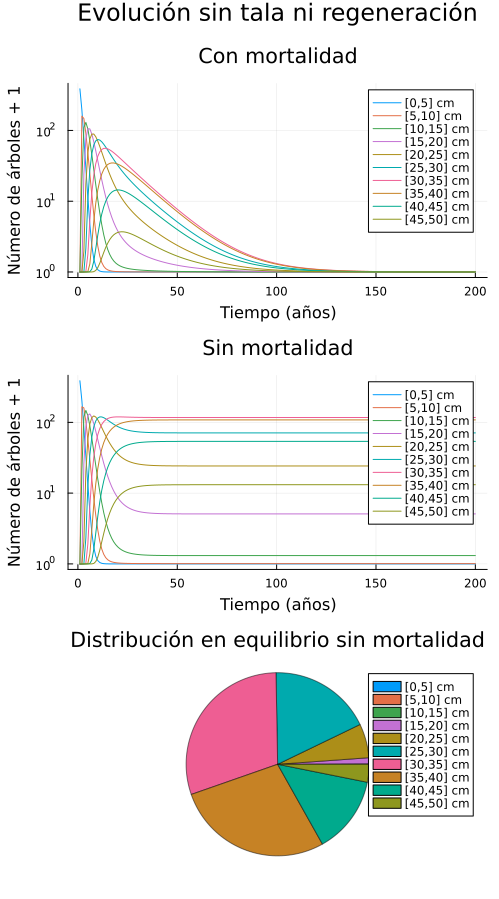

In [18]:
legends = ["[0,5] cm" "[5,10] cm" "[10,15] cm" "[15,20] cm" "[20,25] cm" "[25,30] cm" "[30,35] cm" "[35,40] cm" "[40,45] cm" "[45,50] cm"]
legends_pie = ["[0,5] cm", "[5,10] cm", "[10,15] cm", "[15,20] cm", "[20,25] cm", "[25,30] cm",
     "[30,35] cm", "[35,40] cm", "[40,45] cm", "[45,50] cm"]
     
Z_no_reg =  Array{Float64}(undef, 200, N) 
Z_no_reg_norm =  Array{Float64}(undef, 200, N) 
Z_no_reg[1,:] = transpose(x0_mvp)
Z_no_reg_norm[1,:] = transpose(x0_mvp)

for k in 2:200
    Z_no_reg[k,:] = transpose(Z_no_reg[k-1,:])*tr_mtx
    Z_no_reg_norm[k,:] = transpose(Z_no_reg_norm[k-1,:])*tr_mtx_norm
end 
pie_no_reg = sum_mtx*Z_no_reg_norm[end,:]

p1 = plot(Z_no_reg*transpose(sum_mtx) .+ 1, yaxis=:log10, label = legends, 
    left_margin=5mm, title = "Con mortalidad", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
p2 = plot(Z_no_reg_norm*transpose(sum_mtx) .+ 1, yaxis=:log10, label = legends, 
    title = "Sin mortalidad", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
p3 = pie(legends_pie, pie_no_reg, 
    title = "Distribución en equilibrio sin mortalidad", l = 0.5)
plot(p1, p2, p3, layout=(3,1), size=(500,900), 
plot_title="Evolución sin tala ni regeneración")

### **Con función de regeneración, sin tala:**

Masa total en equilibrio = 

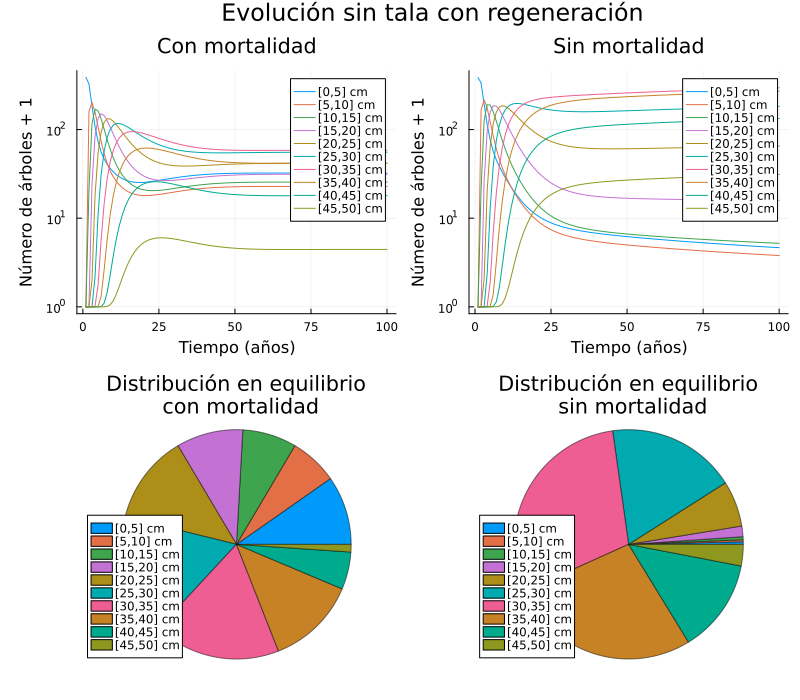

In [19]:
Z_reg =  Array{Float64}(undef, 100, N) 
Z_reg_norm =  Array{Float64}(undef, 100, N) 
Z_reg[1,:] = transpose(x0_mvp)
Z_reg_norm[1,:] = transpose(x0_mvp)
for k in 2:100
    BA = sum(BAs[s] * Z_reg[k-1,s] for s in 2:N)
    Z_reg[k,:] = transpose(Z_reg[k-1,:])*tr_mtx
    Z_reg[k,1] += d_otros(BA)
    BA_norm = sum(BAs[s] * Z_reg_norm[k-1,s] for s in 2:N)
    Z_reg_norm[k,:] = transpose(Z_reg_norm[k-1,:])*tr_mtx_norm
    Z_reg_norm[k,1] += d_otros(BA_norm)
end 
pie_reg = sum_mtx*Z_reg[end,:]
pie_reg_norm = sum_mtx*Z_reg_norm[end,:]

print("Masa total en equilibrio = ")
p1 = plot(Z_reg*transpose(sum_mtx) .+ 1, yaxis=:log10, label = legends, 
    left_margin=5mm, title = "Con mortalidad", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
p2 = plot(Z_reg_norm*transpose(sum_mtx) .+ 1, yaxis=:log10, label = legends, 
    title = "Sin mortalidad", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
p3 = pie(legends_pie, pie_reg, 
    title = "Distribución en equilibrio\n con mortalidad", l = 0.5)
p4 = pie(legends_pie, pie_reg_norm, 
    title = "Distribución en equilibrio\n sin mortalidad", l = 0.5)
plot(p1, p2, p3, p4, layout=(2,2), size=(800,700), 
plot_title="Evolución sin tala con regeneración")

### **Con función de regeneración, con tala:**

Masa total inicial = 385.87
Masa total en equilibrio con mortalidad = 168.36
Masa total en equilibrio sin mortalidad = 180.18


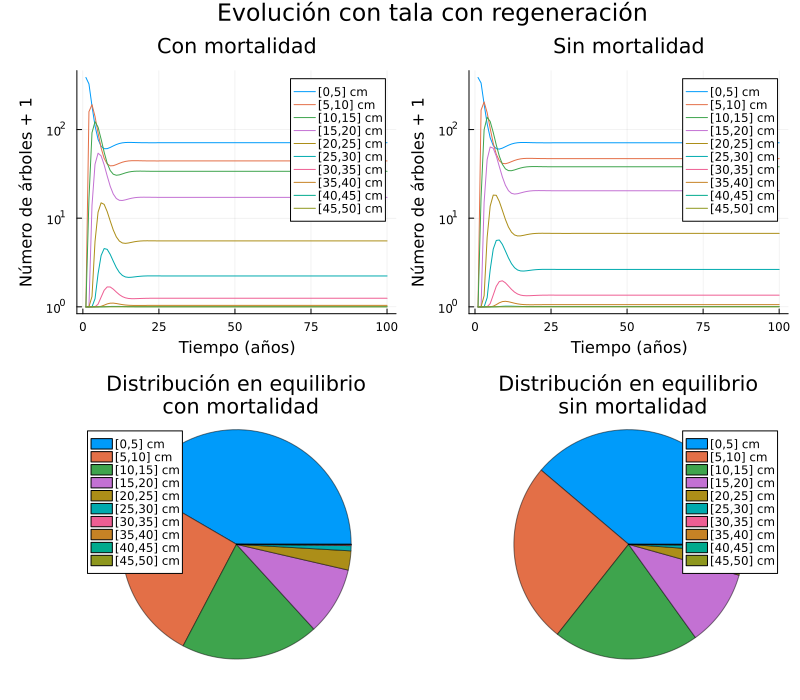

In [20]:
frac_tala = [1, 1, 1, 1, 1,
    0.8, 0.8, 0.8, 0.8, 0.8,
    0.6, 0.6, 0.6, 0.6, 0.6,
    0.4, 0.4, 0.4, 0.4, 0.4,
    0.4, 0.4, 0.4, 0.4, 0.4,
    0.4, 0.4, 0.4, 0.4, 0.4,
]

Z_reg_tala =  Array{Float64}(undef, 100, N) 
Z_reg_tala_norm =  Array{Float64}(undef, 100, N) 
Z_reg_tala[1,:] = transpose(x0_mvp)
Z_reg_tala_norm[1,:] = transpose(x0_mvp)
for k in 2:100
    BA = sum(BAs[s] * Z_reg_tala[k-1,s] for s in 2:N)
    Z_reg_tala[k,:] = transpose(Z_reg_tala[k-1,:])*tr_mtx.*transpose(frac_tala)
    Z_reg_tala[k,1] += d_otros(BA)
    BA_norm = sum(BAs[s] * Z_reg_tala_norm[k-1,s] for s in 2:N)
    Z_reg_tala_norm[k,:] = transpose(Z_reg_tala_norm[k-1,:])*tr_mtx_norm.*transpose(frac_tala)
    Z_reg_tala_norm[k,1] += d_otros(BA_norm)
end 
pie_reg_tala = sum_mtx*Z_reg_tala[end,:]
pie_reg_tala_norm = sum_mtx*Z_reg_tala_norm[end,:]

print("Masa total inicial = ")
println(round(sum(x0_mvp), digits=2))
print("Masa total en equilibrio con mortalidad = ")
println(round(sum(Z_reg_tala[end,:]), digits=2))
print("Masa total en equilibrio sin mortalidad = ")
println(round(sum(Z_reg_tala_norm[end,:]), digits=2))
p1 = plot(Z_reg_tala*transpose(sum_mtx) .+ 1, yaxis=:log10, label = legends, 
    left_margin=5mm, title = "Con mortalidad", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
p2 = plot(Z_reg_tala_norm*transpose(sum_mtx) .+ 1, yaxis=:log10, label = legends, 
    title = "Sin mortalidad", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
p3 = pie(legends_pie, pie_reg_tala, 
    title = "Distribución en equilibrio\n con mortalidad", l = 0.5)
p4 = pie(legends_pie, pie_reg_tala_norm, 
    title = "Distribución en equilibrio\n sin mortalidad", l = 0.5)
plot(p1, p2, p3, p4, layout=(2,2), size=(800,700), 
plot_title="Evolución con tala con regeneración")

# **Modelo de diámetro**

*Simplification of the model introduced in "Self-learning growth simulator for modelling forest stand dynamics in changing conditions", Timo Pukkala, Jari Vauhkonen, Kari T. Korhonen and Tuula Packalen*

## **En función del diámetro individual**

In [21]:
# Aumento de diámetro
coefs_diam_pino = [-7.1552, 0.4415, -0.0685, -0.2027, -0.1236, 1.1198]
coefs_diam_abeto = [-12.7527, 0.1693, -0.0301, -0.1875, -0.0563, 1.9747]
coefs_diam_otros = [-8.6306, 0.5097, -0.0829, -0.3864, -0.0545,  1.3163]

vars_diam = d -> [1, sqrt(d), d, log(25+1), 10/sqrt(d+1), log(1100)]
delta_diam = (d, coefs) -> exp(sum(coefs.*vars_diam(d)))

# Supervivencia
mixed_coefs_survival_pino = [4.1505, 3.1513, -0.3575, -0.4001]
mixed_coefs_survival_abeto = [9.6649, 1.0157, -0.1577, -0.3244]
mixed_coefs_survival_otros = [3.6655, 1.0650, -0.1509, -0.0326]

fixed_coefs_survival_pino = [1.41223, 1.8852, -0.21317, -0.25637]
fixed_coefs_survival_abeto = [5.01677, 0.36902, -0.07504, -0.2319]
fixed_coefs_survival_otros = [1.60895, 0.71578, -0.08236, -0.13481]

vars_survival = d -> [1, sqrt(d), d, 15/sqrt(d+1)]    
survival = (d, coefs) -> 1/(1+exp(-sum(coefs.*vars_survival(d))))

# Ingrowth
coefs_ingrowth_pino = [-6.6933, 1.9051, -0.5035]
coefs_ingrowth_abeto = [-9.6128, 2.2897, -0.8739]
coefs_ingrowth_abedul = [-3.2919, 1.5438, -1.2920]
coefs_ingrowth_otros = [-48.4331,  7.6107, -0.2227]

vars_ingrowth = d -> [1, log(1100), sqrt(25)]
ingrowth = (d, coefs) -> exp(sum(coefs.*vars_ingrowth(d)))

#163 (generic function with 1 method)

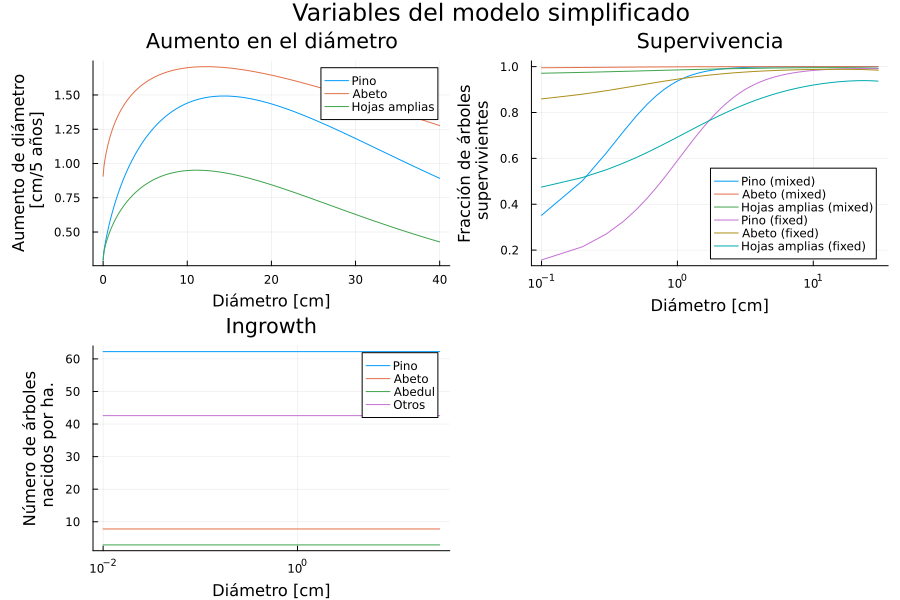

In [22]:
x1 = 0:0.1:40
p1 = plot(x1, 
    [d -> delta_diam(d, coefs_diam_pino), 
    d -> delta_diam(d, coefs_diam_abeto),
    d -> delta_diam(d, coefs_diam_otros),], 
    xlabel="Diámetro [cm]", ylabel="Aumento de diámetro\n [cm/5 años]", left_margin=5mm,
    title="Aumento en el diámetro", label=["Pino" "Abeto" "Hojas amplias"])

x2 = 0.1:0.1:30
p2 = plot(x2, 
    [d -> survival(d,mixed_coefs_survival_pino), d -> survival(d,mixed_coefs_survival_abeto), 
        d -> survival(d,mixed_coefs_survival_otros), d -> survival(d,fixed_coefs_survival_pino), 
        d -> survival(d,fixed_coefs_survival_abeto), d -> survival(d,fixed_coefs_survival_otros)], 
    xaxis=:log10, xlabel="Diámetro [cm]", ylabel="Fracción de árboles\n supervivientes",
    title="Supervivencia",
    label=["Pino (mixed)" "Abeto (mixed)" "Hojas amplias (mixed)" "Pino (fixed)" "Abeto (fixed)" "Hojas amplias (fixed)"])

x3 = 0.01:1:30
p3 = plot(x3, 
    [d -> ingrowth(d,coefs_ingrowth_pino), d -> ingrowth(d,coefs_ingrowth_abeto), 
    d -> ingrowth(d,coefs_ingrowth_abedul), d -> ingrowth(d,coefs_ingrowth_otros)], 
    xaxis=:log10, xlabel="Diámetro [cm]", ylabel="Número de árboles\n nacidos por ha.",
    title="Ingrowth", label=["Pino" "Abeto" "Abedul" "Otros"])
plot(p1, p2, p3, layout=(2,2), size=(900,600), 
plot_title="Variables del modelo simplificado")

In [23]:
Nd = 8
prom_diams = [5*k - 2.5 for k in 1:8]

function tr_diam(Nd, fn)
    tr = zeros(Nd,Nd)
    for i in 1:Nd-1
        help = d -> d + fn(d) - 5*i
        crit = find_zero(help, 5*i)
        frac = (crit - 5*(i-1))/5
        tr[i,i] = frac
        tr[i+1,i] = 1 - frac
    end
    tr[Nd,Nd] = 1
    return tr
end

pino_tr = tr_diam(Nd, d -> delta_diam(d, coefs_diam_pino))
abeto_tr = tr_diam(Nd, d -> delta_diam(d, coefs_diam_abeto))
otros_tr = tr_diam(Nd, d -> delta_diam(d, coefs_diam_otros))

superv_diam = (Nd, fn) -> fn.(prom_diams)
pino_fixed_superv = superv_diam(Nd, d -> survival(d, fixed_coefs_survival_pino))
abeto_fixed_superv = superv_diam(Nd, d -> survival(d, fixed_coefs_survival_abeto))
otros_fixed_superv = superv_diam(Nd, d -> survival(d, fixed_coefs_survival_otros))
pino_mixed_superv = superv_diam(Nd, d -> survival(d, mixed_coefs_survival_pino))
abeto_mixed_superv = superv_diam(Nd, d -> survival(d, mixed_coefs_survival_abeto))
otros_mixed_superv = superv_diam(Nd, d -> survival(d, mixed_coefs_survival_otros))

8-element Vector{Float64}:
 0.9910824930850931
 0.9949466966302875
 0.995554929927939
 0.9953502186213954
 0.9946277170464739
 0.9933671056327632
 0.991407175311288
 0.9884529032408784

In [24]:
function indiv_tray(Nd, Ny, init_val, tr, surv, ingrowth)
    X = Array{Float64}(undef, Ny, Nd)
    X[1,:] = zeros(Nd)
    X[1,1] = init_val
    prom_diams = [5*i + 2.5 for i in 0:7]
    for i in 2:Ny
        X[i,:] = tr * (X[i-1,:] .* surv.(prom_diams))
        X[i,1] += ingrowth(2.5)
    end
    return X
end

indiv_tray (generic function with 1 method)

Masa total inicial = 500.0
Masa total en equilibrio (efectos fijos) = 2231.0247881612504
Masa total en equilibrio (efectos mixtos) = 6436.908827548491


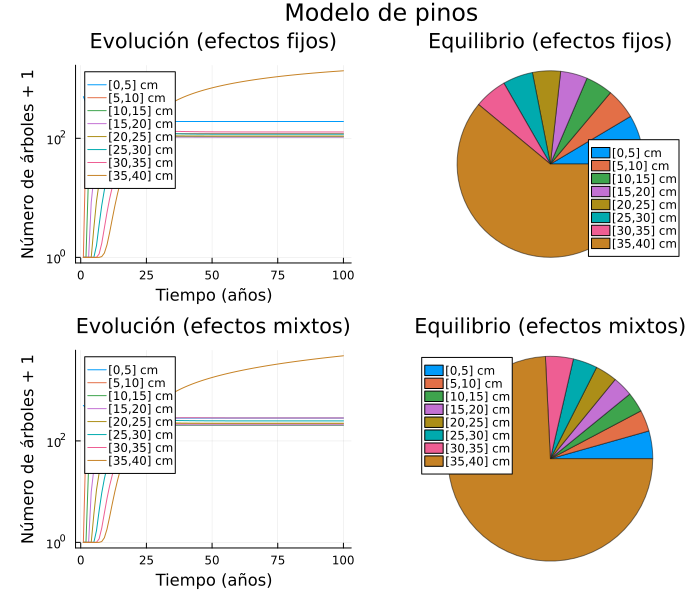

In [25]:
X_pino_fixed = indiv_tray(Nd, 100, 500, pino_tr, 
    d -> survival(d, fixed_coefs_survival_pino), 
    d -> ingrowth(d, coefs_ingrowth_pino))
X_pino_mixed = indiv_tray(Nd, 100, 500, pino_tr, 
    d -> survival(d, mixed_coefs_survival_pino), 
    d -> ingrowth(d, coefs_ingrowth_pino))

print("Masa total inicial = ");println(sum(X_pino_fixed[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(X_pino_fixed[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(X_pino_mixed[end,:]))
pf1 = plot(X_pino_fixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, X_pino_fixed[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pm1 = plot(X_pino_mixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, X_pino_mixed[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
plot(pf1, pf2, pm1, pm2, layout=(2,2), size=(700,600), 
plot_title="Modelo de pinos")

Masa total inicial = 500.0
Masa total en equilibrio (efectos fijos) = 437.71781314102554
Masa total en equilibrio (efectos mixtos) = 1262.4960239584032


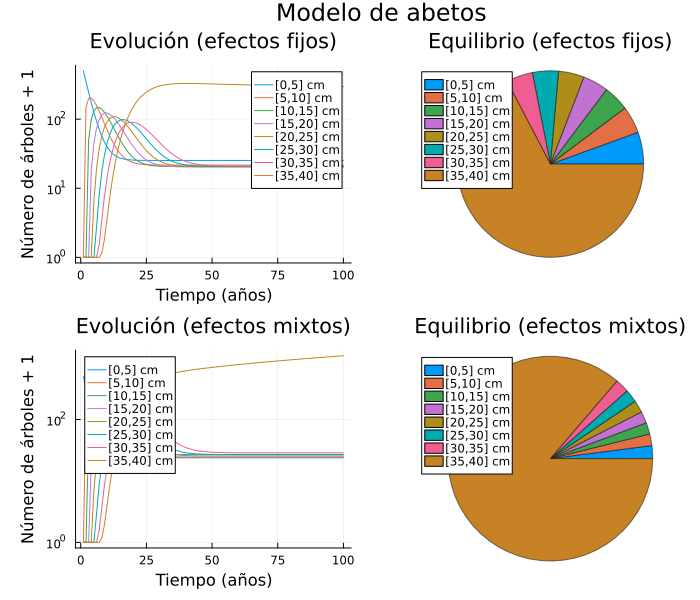

In [26]:
X_abeto_fixed = indiv_tray(Nd, 100, 500, abeto_tr,
    d -> survival(d, fixed_coefs_survival_abeto), 
    d -> ingrowth(d, coefs_ingrowth_abeto))
X_abeto_mixed = indiv_tray(Nd, 100, 500, abeto_tr, 
    d -> survival(d, mixed_coefs_survival_abeto), 
    d -> ingrowth(d, coefs_ingrowth_abeto))

print("Masa total inicial = ");println(sum(X_abeto_fixed[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(X_abeto_fixed[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(X_abeto_mixed[end,:]))
pf1 = plot(X_abeto_fixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, X_abeto_fixed[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pm1 = plot(X_abeto_mixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, X_abeto_mixed[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
plot(pf1, pf2, pm1, pm2, layout=(2,2), size=(700,600), 
plot_title="Modelo de abetos")

Masa total inicial = 500.0
Masa total en equilibrio (efectos fijos) = 25.091025960887702
Masa total en equilibrio (efectos mixtos) = 332.28457269244245


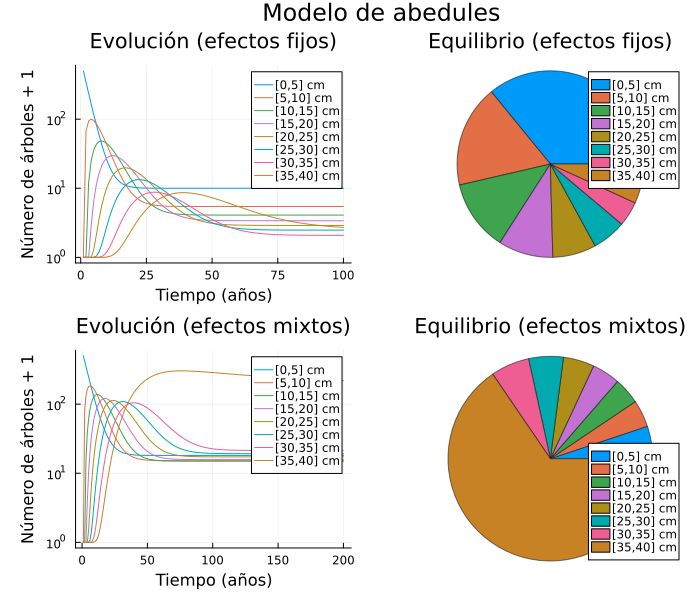

In [27]:
X_abedul_fixed = indiv_tray(Nd, 100, 500, otros_tr,
    d -> survival(d, fixed_coefs_survival_otros), 
    d -> ingrowth(d, coefs_ingrowth_abedul))
X_abedul_mixed = indiv_tray(Nd, 200, 500, otros_tr,
    d -> survival(d, mixed_coefs_survival_otros), 
    d -> ingrowth(d, coefs_ingrowth_abedul))

print("Masa total inicial = ");println(sum(X_abedul_fixed[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(X_abedul_fixed[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(X_abedul_mixed[end,:]))
pf1 = plot(X_abedul_fixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, X_abedul_fixed[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pm1 = plot(X_abedul_mixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, X_abedul_mixed[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
plot(pf1, pf2, pm1, pm2, layout=(2,2), size=(700,600), 
plot_title="Modelo de abedules")

Masa total inicial = 500.0
Masa total en equilibrio (efectos fijos) = 367.5866850445003
Masa total en equilibrio (efectos mixtos) = 4427.433738693218


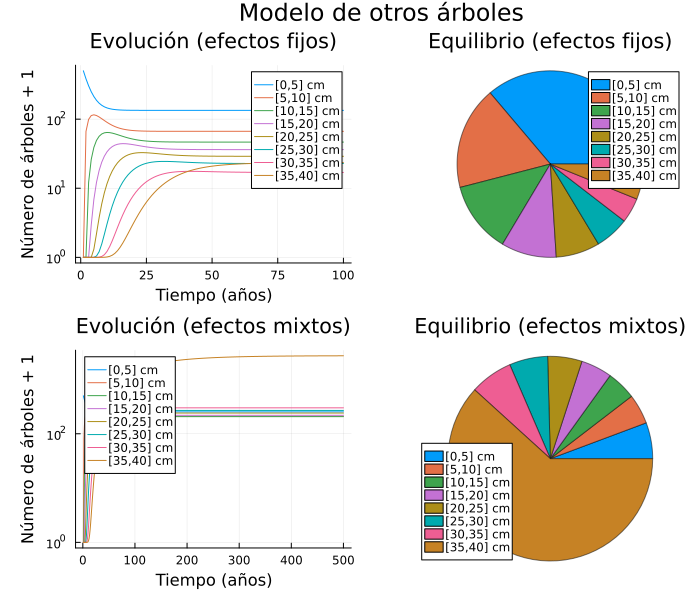

In [28]:
X_otros_fixed = indiv_tray(Nd, 100, 500, otros_tr,
    d -> survival(d, fixed_coefs_survival_otros), 
    d -> ingrowth(d, coefs_ingrowth_otros))
X_otros_mixed = indiv_tray(Nd, 500, 500, otros_tr,
    d -> survival(d, mixed_coefs_survival_otros), 
    d -> ingrowth(d, coefs_ingrowth_otros))

print("Masa total inicial = ");println(sum(X_otros_fixed[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(X_otros_fixed[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(X_otros_mixed[end,:]))
pf1 = plot(X_otros_fixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, X_otros_fixed[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pm1 = plot(X_otros_mixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, X_otros_mixed[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
plot(pf1, pf2, pm1, pm2, layout=(2,2), size=(700,600), 
plot_title="Modelo de otros árboles")

## **En función del conjunto**

In [29]:
BAs = [pi*i^2/40000 for i in 2.5:5:37.5]

function vars_diam_conj(d, X)
    help_BAL = zeros(Nd)
    G = sum(BAs.*X)
    num = floor(Int, d/5) + 1
    help_BAL[num:Nd] .= 1
    BAL = sum(BAs.*X.*help_BAL)
    return [1, sqrt(d), d, log(G+1), BAL/sqrt(d+1), log(1100)]
end
delta_diam_conj = (d, X, coefs) -> exp(sum(coefs.*vars_diam(d,X)))

vars_survival_conj = (d, X) -> [1, sqrt(d), d, sum(BAs.*X)/sqrt(d+1)]    
survival_conj = (d, X, coefs) -> 1/(1+exp(-sum(coefs.*vars_survival_conj(d, X))))

vars_ingrowth_conj = (d, X) -> [1, log(1100), sqrt(sum(BAs.*X))]  
ingrowth_conj = (d, X, coefs) -> exp(sum(coefs.*vars_ingrowth_conj(d, X)))

#259 (generic function with 1 method)

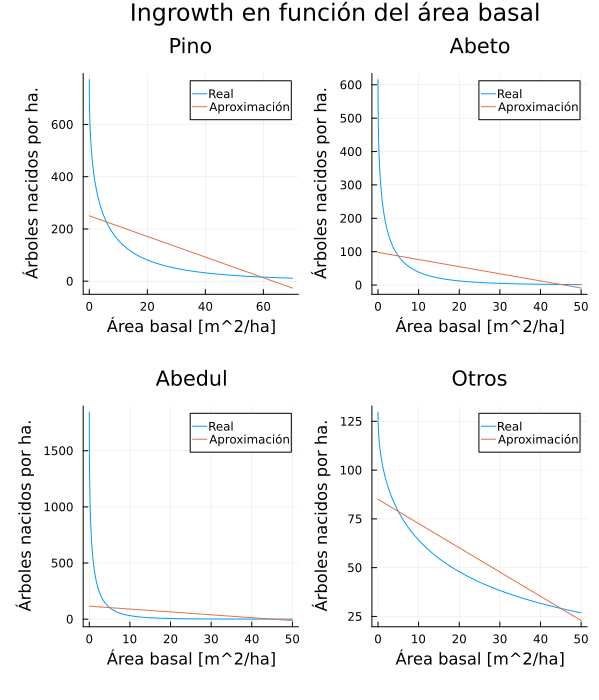

In [30]:
vars_ingrowth_BA = BA -> [1, log(1100), sqrt(BA)]  
ingrowth_conj_BA = (BA, coefs) -> exp(sum(coefs.*vars_ingrowth_BA(BA)))
y1_pino, y2_pino = ingrowth_conj_BA(5,coefs_ingrowth_pino), ingrowth_conj_BA(65,coefs_ingrowth_pino)
y1_abeto, y2_abeto = ingrowth_conj_BA(5,coefs_ingrowth_abeto), ingrowth_conj_BA(45,coefs_ingrowth_abeto)
y1_abedul, y2_abedul = ingrowth_conj_BA(5,coefs_ingrowth_abedul), ingrowth_conj_BA(45,coefs_ingrowth_abedul)
y1_otros, y2_otros = ingrowth_conj_BA(5,coefs_ingrowth_otros), ingrowth_conj_BA(45,coefs_ingrowth_otros)
p1 = plot([BA -> ingrowth_conj_BA(BA,coefs_ingrowth_pino), 
    BA -> (y2_pino-y1_pino)*(BA)/60 + y1_pino], 0, 70, 
    xlabel="Área basal [m^2/ha]", ylabel="Árboles nacidos por ha.",
    title="Pino", label=["Real" "Aproximación"],
    left_margin=5mm, bottom_margin=5mm)
p2 = plot([BA -> ingrowth_conj_BA(BA,coefs_ingrowth_abeto), 
    BA -> (y2_abeto-y1_abeto)*(BA-5)/40 + y1_abeto], 0, 50,
    xlabel="Área basal [m^2/ha]", ylabel="Árboles nacidos por ha.",
    title="Abeto", label=["Real" "Aproximación"],
    bottom_margin=5mm)
p3 = plot([BA -> ingrowth_conj_BA(BA,coefs_ingrowth_abedul), 
    BA -> (y2_abedul-y1_abedul)*(BA-5)/40 + y1_abedul], 0, 50,
    xlabel="Área basal [m^2/ha]", ylabel="Árboles nacidos por ha.",
    title="Abedul", label=["Real" "Aproximación"],
    left_margin=5mm, bottom_margin=5mm)
p4 = plot([BA -> ingrowth_conj_BA(BA,coefs_ingrowth_otros), 
    BA -> (y2_otros-y1_otros)*(BA-5)/40 + y1_otros], 0, 50,
    xlabel="Área basal [m^2/ha]", ylabel="Árboles nacidos por ha.",
    title="Otros", label=["Real" "Aproximación"],
    bottom_margin=5mm)
plot(p1, p2, p3, p4, layout=(2,2), size=(600,700), 
plot_title="Ingrowth en función del área basal")

In [31]:
function tray_conj(Nd, Ny, init_val, tr, surv, ingrowth)
    X = Array{Float64}(undef, Ny, Nd)
    X[1,:] = zeros(Nd)
    X[1,1] = init_val
    for i in 2:Ny
        Z = X[i-1,:]
        prob = zeros(Nd)
        for k in 1:8
            prob[k] = surv(prom_diams[k], Z)
        end
        X[i,:] = tr * (X[i-1,:] .* prob)
        X[i,1] += ingrowth(2.5, Z)
    end
    return X
end

tray_conj (generic function with 1 method)

Masa total inicial = 600.0
Masa total en T=300 (efectos fijos) = 432.66538002868003
Masa total en T=300 (efectos mixtos) = 479.8579965053115


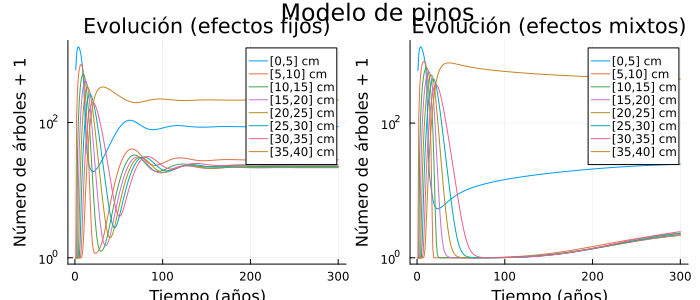

In [32]:
X_pino_fixed = tray_conj(Nd, 300, 600, pino_tr, 
    (d, X) -> survival_conj(d, X, fixed_coefs_survival_pino), 
    (d, X) -> ingrowth_conj(d, X, coefs_ingrowth_pino))
X_pino_mixed = tray_conj(Nd, 300, 600, pino_tr, 
    (d, X) -> survival_conj(d, X, mixed_coefs_survival_pino), 
    (d, X) -> ingrowth_conj(d, X, coefs_ingrowth_pino))

print("Masa total inicial = ");println(sum(X_pino_fixed[1,:]))
print("Masa total en T=300 (efectos fijos) = ");println(sum(X_pino_fixed[end,:]))
print("Masa total en T=300 (efectos mixtos) = ");println(sum(X_pino_mixed[end,:]))
pf = plot(X_pino_fixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm = plot(X_pino_mixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf, pm, layout=(1,2), size=(700,300), 
plot_title="Modelo de pinos")

Masa total inicial = 600.0
Masa total en T=500 (efectos fijos) = 310.4277674406445
Masa total en T=500 (efectos mixtos) = 515.451007359991


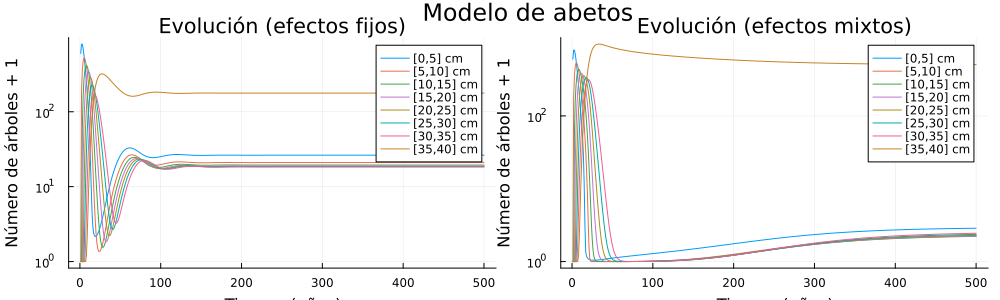

In [33]:
X_abeto_fixed = tray_conj(Nd, 500, 600, abeto_tr, 
    (d, X) -> survival_conj(d, X, fixed_coefs_survival_abeto), 
    (d, X) -> ingrowth_conj(d, X, coefs_ingrowth_abeto))
X_abeto_mixed = tray_conj(Nd, 500, 600, abeto_tr, 
    (d, X) -> survival_conj(d, X, mixed_coefs_survival_abeto), 
    (d, X) -> ingrowth_conj(d, X, coefs_ingrowth_abeto))

print("Masa total inicial = ");println(sum(X_abeto_fixed[1,:]))
print("Masa total en T=500 (efectos fijos) = ");println(sum(X_abeto_fixed[end,:]))
print("Masa total en T=500 (efectos mixtos) = ");println(sum(X_abeto_mixed[end,:]))
pf = plot(X_abeto_fixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm = plot(X_abeto_mixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf, pm, layout=(1,2), size=(1000,300), 
plot_title="Modelo de abetos")

Masa total inicial = 600.0
Masa total en T=300 (efectos fijos) = 376.63470321325013
Masa total en T=2000 (efectos mixtos) = 304.29763195015005


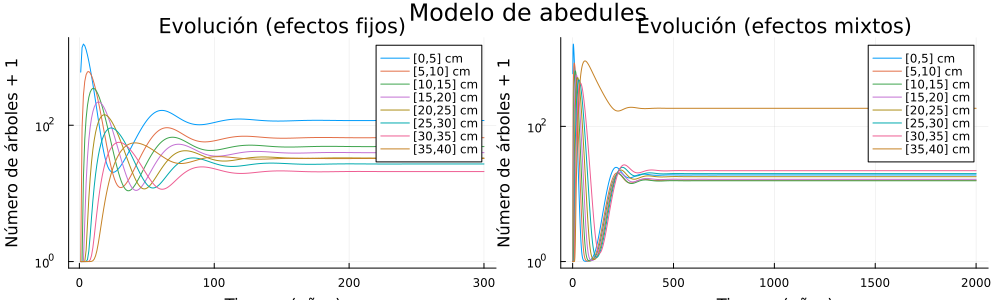

In [34]:
X_abedul_fixed = tray_conj(Nd, 300, 600, otros_tr, 
    (d, X) -> survival_conj(d, X, fixed_coefs_survival_otros), 
    (d, X) -> ingrowth_conj(d, X, coefs_ingrowth_abedul))
X_abedul_mixed = tray_conj(Nd, 2000, 600, otros_tr, 
    (d, X) -> survival_conj(d, X, mixed_coefs_survival_otros), 
    (d, X) -> ingrowth_conj(d, X, coefs_ingrowth_abedul))

print("Masa total inicial = ");println(sum(X_abedul_fixed[1,:]))
print("Masa total en T=300 (efectos fijos) = ");println(sum(X_abedul_fixed[end,:]))
print("Masa total en T=2000 (efectos mixtos) = ");println(sum(X_abedul_mixed[end,:]))
pf = plot(X_abedul_fixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm = plot(X_abedul_mixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf, pm, layout=(1,2), size=(1000,300), 
plot_title="Modelo de abedules")

Masa total inicial = 600.0
Masa total en T=200 (efectos fijos) = 561.1307883680221
Masa total en T=200 (efectos mixtos) = 1153.5172158189653


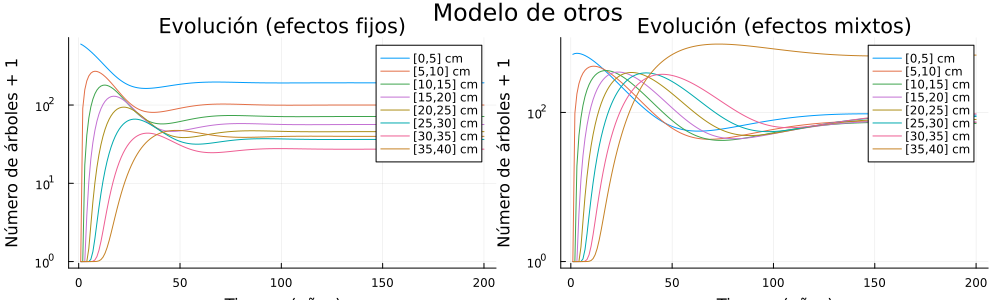

In [35]:
X_otros_fixed = tray_conj(Nd, 200, 600, otros_tr, 
    (d, X) -> survival_conj(d, X, fixed_coefs_survival_otros), 
    (d, X) -> ingrowth_conj(d, X, coefs_ingrowth_otros))
X_otros_mixed = tray_conj(Nd, 200, 600, otros_tr, 
    (d, X) -> survival_conj(d, X, mixed_coefs_survival_otros), 
    (d, X) -> ingrowth_conj(d, X, coefs_ingrowth_otros))

print("Masa total inicial = ");println(sum(X_otros_fixed[1,:]))
print("Masa total en T=200 (efectos fijos) = ");println(sum(X_otros_fixed[end,:]))
print("Masa total en T=200 (efectos mixtos) = ");println(sum(X_otros_mixed[end,:]))
pf = plot(X_otros_fixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm = plot(X_otros_mixed .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf, pm, layout=(1,2), size=(1000,300), 
plot_title="Modelo de otros")

In [36]:
f = [0.8, 2.8, 4.2, 12.4, 16.99, 50.2, 68.1, 84] # biomass coeffcients
UB = 8000
test_BA = 25

25

## **Optimización independiente del área basal**

In [38]:
model_pino_mixed1 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_pino_mixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(pino_tr[s,t]*((x[t].in - c[t])*pino_mixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == pino_tr[1,1]*(x[1].in - c[1])*pino_mixed_superv[1] + ingrowth_conj_BA(test_BA, coefs_ingrowth_pino)
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_pino_mixed1)
SDDP.train(model_pino_mixed1, iteration_limit = 50)

simulations = SDDP.simulate(model_pino_mixed1, 2000, [:x, :c, :BA])
Y_pino_mixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_pino_mixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_pino_mixed1 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_pino_mixed1)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

In [39]:
model_pino_fixed = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_pino_fixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(pino_tr[s,t]*((x[t].in - c[t])*pino_fixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == pino_tr[1,1]*(x[1].in - c[1])*pino_fixed_superv[1] + ingrowth(test_BA, coefs_ingrowth_pino)
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_pino_fixed)
SDDP.train(model_pino_fixed, iteration_limit = n_train_iterations)
# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_pino_fixed, 10000, [:x, :c, :BA])
Y_pino_fixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_pino_fixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_pino_fixed1 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]

μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_pino_fixed)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

Masa total inicial = 600.0
Masa total en equilibrio (efectos fijos) = 869.8198151412538
Masa total en equilibrio (efectos mixtos) = 1659.1904022789004
Área basal total máxima (efectos fijos) = 26.659446737086675
Área basal total máxima (efectos mixtos) = 56.642148078142675


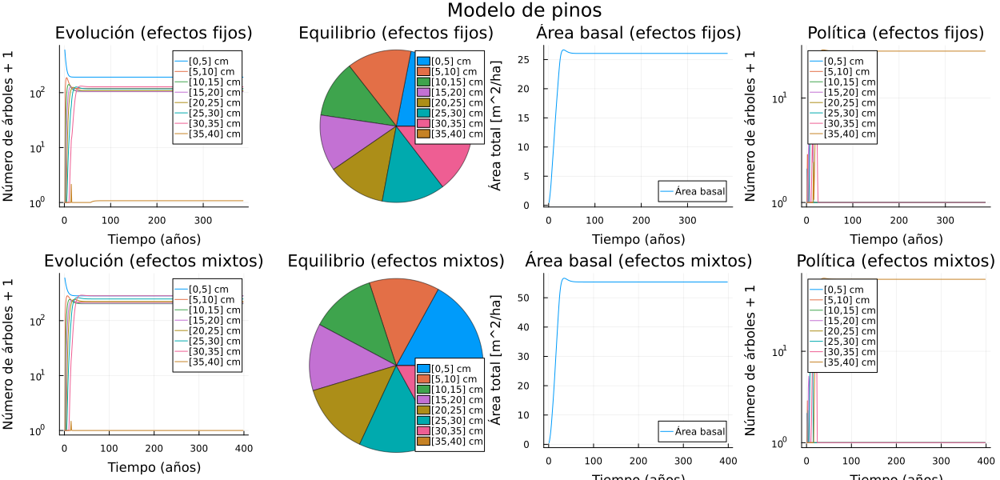

In [40]:
print("Masa total inicial = ");println(sum(Y_pino_fixed1[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(Y_pino_fixed1[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(Y_pino_mixed1[end,:]))
print("Área basal total máxima (efectos fijos) = ");println(maximum(BA_pino_fixed1))
print("Área basal total máxima (efectos mixtos) = ");println(maximum(BA_pino_mixed1))
pf1 = plot(Y_pino_fixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm, bottom_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, Y_pino_fixed1[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pf3 = plot(BA_pino_fixed1, label="Área basal", title="Área basal (efectos fijos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pf4 = plot(C_pino_fixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm1 = plot(Y_pino_mixed1 .+ 1, yaxis=:log10, label = legends, bottom_margin=5mm,
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, Y_pino_mixed1[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
pm3 = plot(BA_pino_mixed1, label="Área basal", title="Área basal (efectos mixtos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pm4 = plot(C_pino_mixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos mixtos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf1, pf2, pf3, pf4, pm1, pm2, pm3, pm4, layout=(2,4), size=(1250,600), 
plot_title="Modelo de pinos")

In [41]:
model_abeto_mixed1 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_abeto_mixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(abeto_tr[s,t]*((x[t].in - c[t])*abeto_mixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == abeto_tr[1,1]*(x[1].in - c[1])*abeto_mixed_superv[1] + ingrowth(test_BA, coefs_ingrowth_abeto)
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_abeto_mixed1)

SDDP.train(model_abeto_mixed1, iteration_limit = n_train_iterations)
# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_abeto_mixed1, n_simulations, [:x, :c, :BA])
Y_abeto_mixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_abeto_mixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_abeto_mixed1 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_abeto_mixed1)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

In [42]:
model_abeto_fixed1 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_abeto_fixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(abeto_tr[s,t]*((x[t].in - c[t])*abeto_fixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == abeto_tr[1,1]*(x[1].in - c[1])*abeto_fixed_superv[1] + ingrowth(test_BA, coefs_ingrowth_abeto)
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_abeto_fixed1)
SDDP.train(model_abeto_fixed1, iteration_limit = n_train_iterations)

# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_abeto_fixed1, n_simulations, [:x, :c, :BA])
Y_abeto_fixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_abeto_fixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_abeto_fixed1 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_abeto_fixed1)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

Masa total inicial = 600.0
Masa total en equilibrio (efectos fijos) = 142.9804145664568
Masa total en equilibrio (efectos mixtos) = 173.05502964978606
Área basal total máxima (efectos fijos) = 18.810863756846892
Área basal total máxima (efectos mixtos) = 24.80577057473819


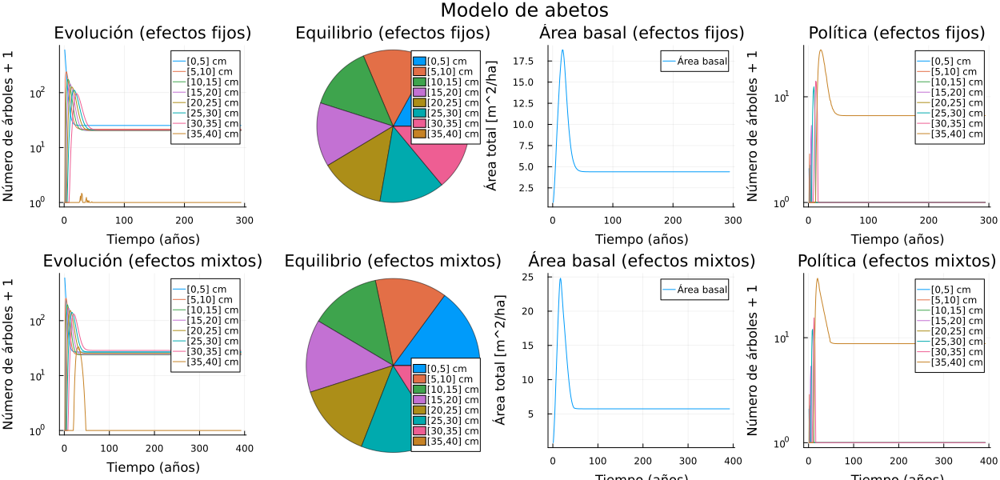

In [43]:
print("Masa total inicial = ");println(sum(Y_abeto_fixed1[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(Y_abeto_fixed1[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(Y_abeto_mixed1[end,:]))
print("Área basal total máxima (efectos fijos) = ");println(maximum(BA_abeto_fixed1))
print("Área basal total máxima (efectos mixtos) = ");println(maximum(BA_abeto_mixed1))
pf1 = plot(Y_abeto_fixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm, bottom_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, Y_abeto_fixed1[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pf3 = plot(BA_abeto_fixed1, label="Área basal", title="Área basal (efectos fijos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pf4 = plot(C_abeto_fixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm1 = plot(Y_abeto_mixed1 .+ 1, yaxis=:log10, label = legends, bottom_margin=5mm,
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, Y_abeto_mixed1[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
pm3 = plot(BA_abeto_mixed1, label="Área basal", title="Área basal (efectos mixtos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pm4 = plot(C_abeto_mixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos mixtos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf1, pf2, pf3, pf4, pm1, pm2, pm3, pm4, layout=(2,4), size=(1250,600), 
plot_title="Modelo de abetos")

In [44]:
model_abedul_mixed1 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_abedul_mixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(otros_tr[s,t]*((x[t].in - c[t])*otros_mixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == otros_tr[1,1]*(x[1].in - c[1])*otros_mixed_superv[1] + ingrowth(test_BA, coefs_ingrowth_abedul)
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end
SDDP.numerical_stability_report(model_abedul_mixed1)
SDDP.train(model_abedul_mixed1, iteration_limit = n_train_iterations)

# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_abedul_mixed1, n_simulations, [:x, :c, :BA])
Y_abedul_mixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_abedul_mixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_abedul_mixed1 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_abedul_mixed1)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

In [45]:
model_abedul_fixed2 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_abedul_fixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(otros_tr[s,t]*((x[t].in - c[t])*otros_fixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == otros_tr[1,1]*(x[1].in - c[1])*otros_fixed_superv[1] + ingrowth(test_BA, coefs_ingrowth_abedul)
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end
SDDP.numerical_stability_report(model_abedul_fixed2)

SDDP.train(model_abedul_fixed2, iteration_limit = n_train_iterations)
# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_abedul_fixed2, n_simulations, [:x, :c, :BA])
Y_abedul_fixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_abedul_fixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_abedul_fixed1 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_abedul_fixed2)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

Masa total inicial = 600.0
Masa total en equilibrio (efectos fijos) = 21.09107679519418
Masa total en equilibrio (efectos mixtos) = 105.86091963896563
Área basal total máxima (efectos fijos) = 1.9548090645004872
Área basal total máxima (efectos mixtos) = 14.475764790583625


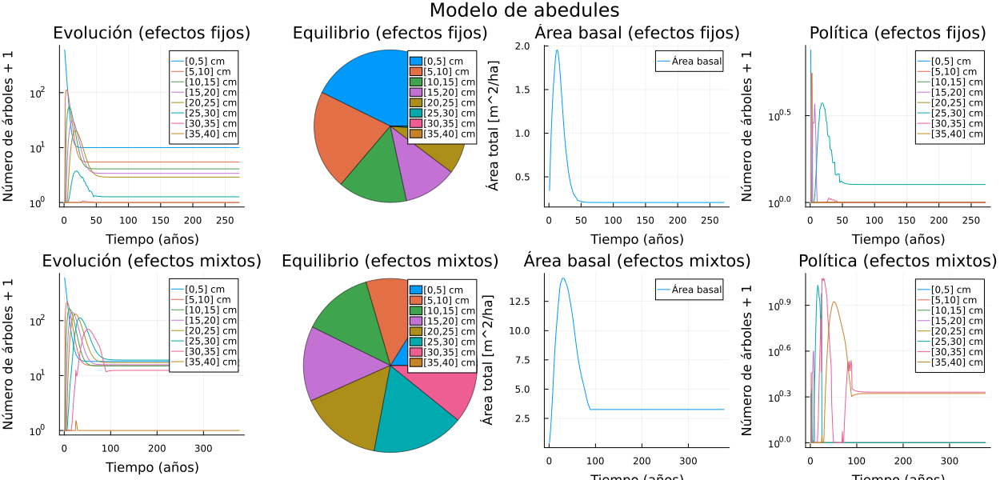

In [46]:
print("Masa total inicial = ");println(sum(Y_abedul_fixed1[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(Y_abedul_fixed1[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(Y_abedul_mixed1[end,:]))
print("Área basal total máxima (efectos fijos) = ");println(maximum(BA_abedul_fixed1))
print("Área basal total máxima (efectos mixtos) = ");println(maximum(BA_abedul_mixed1))
pf1 = plot(Y_abedul_fixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm, bottom_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, Y_abedul_fixed1[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pf3 = plot(BA_abedul_fixed1, label="Área basal", title="Área basal (efectos fijos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pf4 = plot(C_abedul_fixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm1 = plot(Y_abedul_mixed1 .+ 1, yaxis=:log10, label = legends, bottom_margin=5mm,
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, Y_abedul_mixed1[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
pm3 = plot(BA_abedul_mixed1, label="Área basal", title="Área basal (efectos mixtos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pm4 = plot(C_abedul_mixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos mixtos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf1, pf2, pf3, pf4, pm1, pm2, pm3, pm4, layout=(2,4), size=(1250,600), 
plot_title="Modelo de abedules")

In [47]:
model_otros_mixed1 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_otros_mixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(otros_tr[s,t]*((x[t].in - c[t])*otros_mixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == otros_tr[1,1]*(x[1].in - c[1])*otros_mixed_superv[1] + ingrowth(test_BA, coefs_ingrowth_otros)
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_otros_mixed1)
SDDP.train(model_otros_mixed1, iteration_limit = n_train_iterations)

# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_otros_mixed1, n_simulations, [:x, :c, :BA])
Y_otros_mixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_otros_mixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_otros_mixed1 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_otros_mixed1)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

In [48]:
model_otros_fixed1 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_otros_fixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(otros_tr[s,t]*((x[t].in - c[t])*otros_fixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == otros_tr[1,1]*(x[1].in - c[1])*otros_fixed_superv[1] + ingrowth(test_BA, coefs_ingrowth_otros)
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_otros_fixed1)
SDDP.train(model_otros_fixed1, iteration_limit = n_train_iterations)

# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_otros_fixed1, n_simulations, [:x, :c, :BA])
Y_otros_fixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_otros_fixed1 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_otros_fixed1 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_otros_fixed1)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

Masa total inicial = 600.0
Masa total en equilibrio (efectos fijos) = 311.390540697384
Masa total en equilibrio (efectos mixtos) = 1428.9198151659464
Área basal total máxima (efectos fijos) = 3.391970219444532
Área basal total máxima (efectos mixtos) = 37.4208961274386


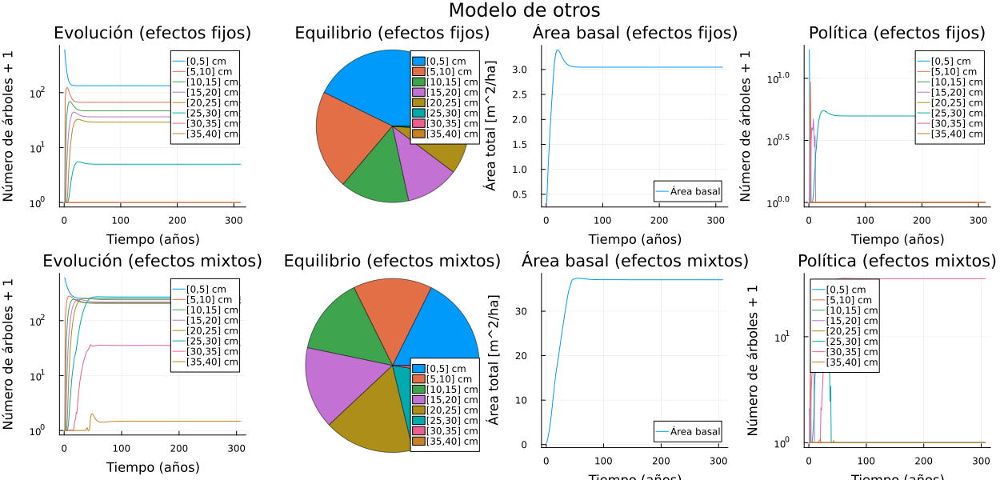

In [49]:
print("Masa total inicial = ");println(sum(Y_otros_fixed1[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(Y_otros_fixed1[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(Y_otros_mixed1[end,:]))
print("Área basal total máxima (efectos fijos) = ");println(maximum(BA_otros_fixed1))
print("Área basal total máxima (efectos mixtos) = ");println(maximum(BA_otros_mixed1))
pf1 = plot(Y_otros_fixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm, bottom_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, Y_otros_fixed1[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pf3 = plot(BA_otros_fixed1, label="Área basal", title="Área basal (efectos fijos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pf4 = plot(C_otros_fixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm1 = plot(Y_otros_mixed1 .+ 1, yaxis=:log10, label = legends, bottom_margin=5mm,
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, Y_otros_mixed1[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
pm3 = plot(BA_otros_mixed1, label="Área basal", title="Área basal (efectos mixtos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pm4 = plot(C_otros_mixed1 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos mixtos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf1, pf2, pf3, pf4, pm1, pm2, pm3, pm4, layout=(2,4), size=(1250,600), 
plot_title="Modelo de otros")

## **Optimización dependiente del área basal**

In [50]:
model_pino_mixed2 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_pino_mixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(pino_tr[s,t]*((x[t].in - c[t])*pino_mixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == pino_tr[1,1]*(x[1].in - c[1])*pino_mixed_superv[1] + (y2_pino-y1_pino)*(BA)/60 + y1_pino
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_pino_mixed2)
SDDP.train(model_pino_mixed2, iteration_limit = 20)

simulations = SDDP.simulate(model_pino_mixed2, 2000, [:x, :c, :BA])
Y_pino_mixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_pino_mixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_pino_mixed2 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_pino_mixed2)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 3e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

In [51]:
model_pino_fixed2 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_pino_fixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(pino_tr[s,t]*((x[t].in - c[t])*pino_fixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == pino_tr[1,1]*(x[1].in - c[1])*pino_fixed_superv[1] + (y2_pino-y1_pino)*(BA)/60 + y1_pino
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_pino_fixed2)
SDDP.train(model_pino_fixed2, iteration_limit = n_train_iterations)
# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_pino_fixed2, n_simulations, [:x, :c, :BA])
Y_pino_fixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_pino_fixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_pino_fixed2 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]

μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_pino_fixed2)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 3e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

Masa total inicial = 600.0
Masa total en equilibrio (efectos fijos) = 1591.9602217887775
Masa total en equilibrio (efectos mixtos) = 1996.8989582276008
Área basal total máxima (efectos fijos) = 29.752637558008942
Área basal total máxima (efectos mixtos) = 51.36115419686651


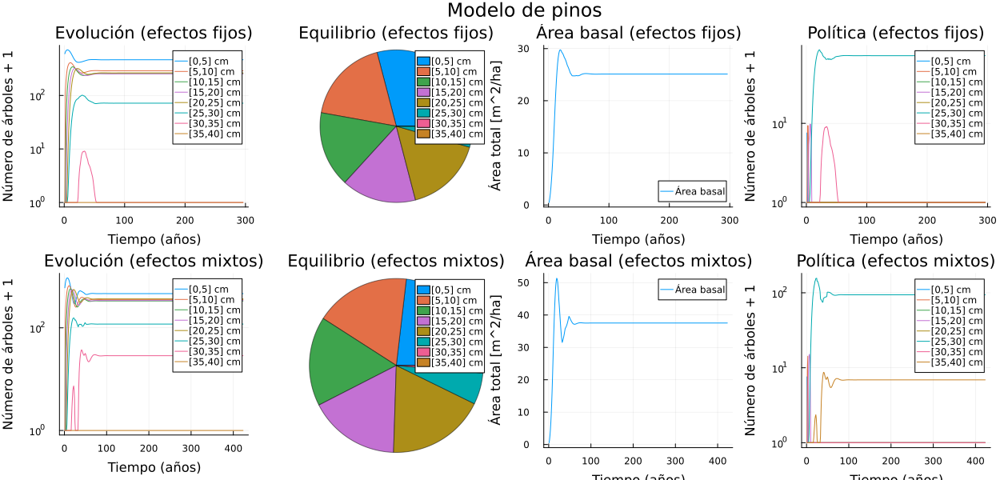

In [52]:
print("Masa total inicial = ");println(sum(Y_pino_fixed2[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(Y_pino_fixed2[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(Y_pino_mixed2[end,:]))
print("Área basal total máxima (efectos fijos) = ");println(maximum(BA_pino_fixed2))
print("Área basal total máxima (efectos mixtos) = ");println(maximum(BA_pino_mixed2))
pf1 = plot(Y_pino_fixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm, bottom_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, Y_pino_fixed2[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pf3 = plot(BA_pino_fixed2, label="Área basal", title="Área basal (efectos fijos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pf4 = plot(C_pino_fixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm1 = plot(Y_pino_mixed2 .+ 1, yaxis=:log10, label = legends, bottom_margin=5mm,
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, Y_pino_mixed2[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
pm3 = plot(BA_pino_mixed2, label="Área basal", title="Área basal (efectos mixtos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pm4 = plot(C_pino_mixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos mixtos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf1, pf2, pf3, pf4, pm1, pm2, pm3, pm4, layout=(2,4), size=(1250,600), 
plot_title="Modelo de pinos")

In [53]:
model_abeto_mixed2 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_abeto_mixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(abeto_tr[s,t]*((x[t].in - c[t])*abeto_mixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == abeto_tr[1,1]*(x[1].in - c[1])*abeto_mixed_superv[1] + (y2_abeto-y1_abeto)*(BA-5)/40 + y1_abeto
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_abeto_mixed2)

SDDP.train(model_abeto_mixed2, iteration_limit = n_train_iterations)
# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_abeto_mixed2, n_simulations, [:x, :c, :BA])
Y_abeto_mixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_abeto_mixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_abeto_mixed2 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_abeto_mixed2)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

In [54]:
model_abeto_fixed2 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_abeto_fixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(abeto_tr[s,t]*((x[t].in - c[t])*abeto_fixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == abeto_tr[1,1]*(x[1].in - c[1])*abeto_fixed_superv[1] + (y2_abeto-y1_abeto)*(BA-5)/40 + y1_abeto
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_abeto_fixed2)
SDDP.train(model_abeto_fixed2, iteration_limit = n_train_iterations)

# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_abeto_fixed2, n_simulations, [:x, :c, :BA])
Y_abeto_fixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_abeto_fixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_abeto_fixed2 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_abeto_fixed2)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

Masa total inicial = 600.0
Masa total en equilibrio (efectos fijos) = 814.2052531878483
Masa total en equilibrio (efectos mixtos) = 844.2271975680223
Área basal total máxima (efectos fijos) = 27.354582616780835
Área basal total máxima (efectos mixtos) = 32.52781884327917


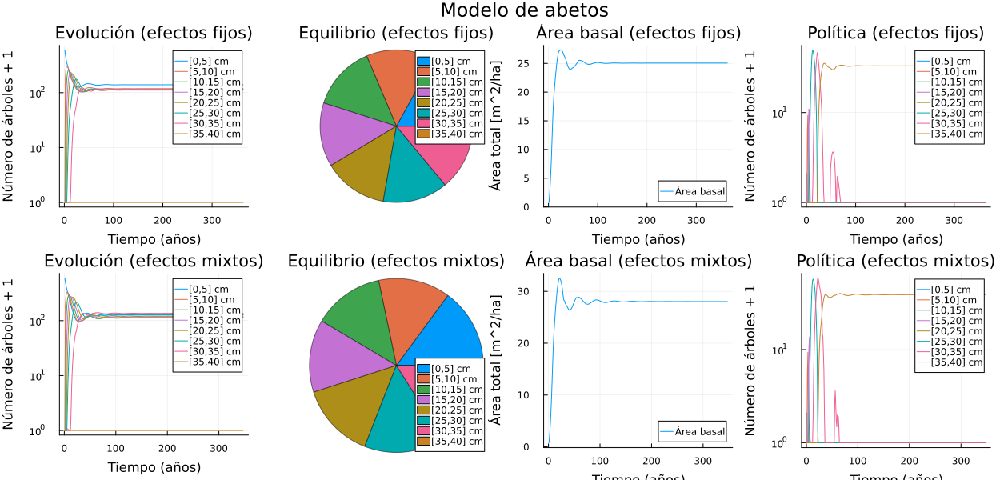

In [55]:
print("Masa total inicial = ");println(sum(Y_abeto_fixed2[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(Y_abeto_fixed2[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(Y_abeto_mixed2[end,:]))
print("Área basal total máxima (efectos fijos) = ");println(maximum(BA_abeto_fixed2))
print("Área basal total máxima (efectos mixtos) = ");println(maximum(BA_abeto_mixed2))
pf1 = plot(Y_abeto_fixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm, bottom_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, Y_abeto_fixed2[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pf3 = plot(BA_abeto_fixed2, label="Área basal", title="Área basal (efectos fijos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pf4 = plot(C_abeto_fixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm1 = plot(Y_abeto_mixed2 .+ 1, yaxis=:log10, label = legends, bottom_margin=5mm,
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, Y_abeto_mixed2[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
pm3 = plot(BA_abeto_mixed2, label="Área basal", title="Área basal (efectos mixtos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pm4 = plot(C_abeto_mixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos mixtos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf1, pf2, pf3, pf4, pm1, pm2, pm3, pm4, layout=(2,4), size=(1250,600), 
plot_title="Modelo de abetos")

In [56]:
model_abedul_mixed2 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_abedul_mixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(otros_tr[s,t]*((x[t].in - c[t])*otros_mixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == otros_tr[1,1]*(x[1].in - c[1])*otros_mixed_superv[1] + (y2_abedul-y1_abedul)*(BA-5)/40 + y1_abedul
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end
SDDP.numerical_stability_report(model_abedul_mixed2)
SDDP.train(model_abedul_mixed2, iteration_limit = n_train_iterations)

# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_abedul_mixed2, n_simulations, [:x, :c, :BA])
Y_abedul_mixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_abedul_mixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_abedul_mixed2 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_abedul_mixed2)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

In [57]:
model_abedul_fixed2 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_abedul_fixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(otros_tr[s,t]*((x[t].in - c[t])*otros_fixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == otros_tr[1,1]*(x[1].in - c[1])*otros_fixed_superv[1] + (y2_abedul-y1_abedul)*(BA-5)/40 + y1_abedul
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end
SDDP.numerical_stability_report(model_abedul_fixed2)

SDDP.train(model_abedul_fixed2, iteration_limit = n_train_iterations)
# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_abedul_fixed2, n_simulations, [:x, :c, :BA])
Y_abedul_fixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_abedul_fixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_abedul_fixed2 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_abedul_fixed2)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

Masa total inicial = 600.0
Masa total en equilibrio (efectos fijos) = 712.9519003526339
Masa total en equilibrio (efectos mixtos) = 1415.2374671718412
Área basal total máxima (efectos fijos) = 7.155004224594655
Área basal total máxima (efectos mixtos) = 33.71128119165687


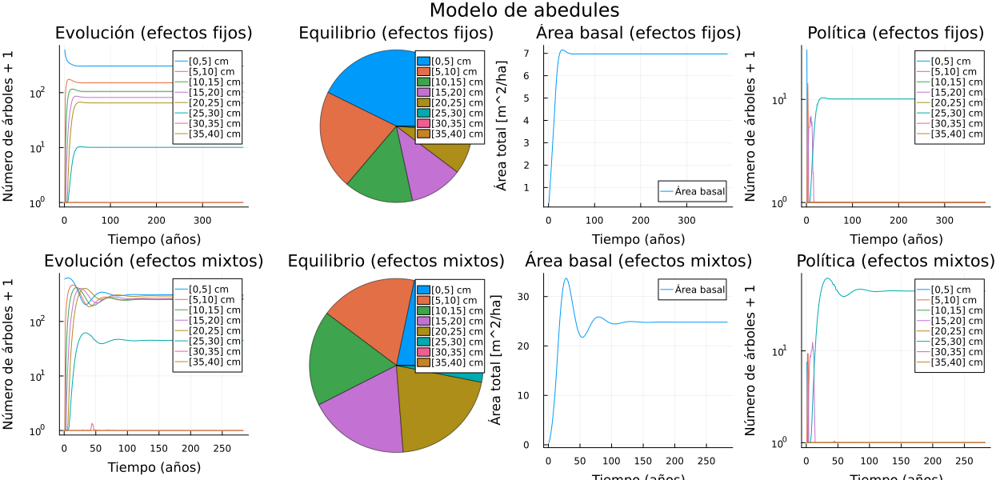

In [58]:
print("Masa total inicial = ");println(sum(Y_abedul_fixed2[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(Y_abedul_fixed2[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(Y_abedul_mixed2[end,:]))
print("Área basal total máxima (efectos fijos) = ");println(maximum(BA_abedul_fixed2))
print("Área basal total máxima (efectos mixtos) = ");println(maximum(BA_abedul_mixed2))
pf1 = plot(Y_abedul_fixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm, bottom_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, Y_abedul_fixed2[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pf3 = plot(BA_abedul_fixed2, label="Área basal", title="Área basal (efectos fijos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pf4 = plot(C_abedul_fixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm1 = plot(Y_abedul_mixed2 .+ 1, yaxis=:log10, label = legends, bottom_margin=5mm,
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, Y_abedul_mixed2[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
pm3 = plot(BA_abedul_mixed2, label="Área basal", title="Área basal (efectos mixtos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pm4 = plot(C_abedul_mixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos mixtos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf1, pf2, pf3, pf4, pm1, pm2, pm3, pm4, layout=(2,4), size=(1250,600), 
plot_title="Modelo de abedules")

In [59]:
model_otros_mixed2 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_otros_mixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(otros_tr[s,t]*((x[t].in - c[t])*otros_mixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == otros_tr[1,1]*(x[1].in - c[1])*otros_mixed_superv[1] + (y2_otros-y1_otros)*(BA-5)/40 + y1_otros
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_otros_mixed2)
SDDP.train(model_otros_mixed2, iteration_limit = n_train_iterations)

# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_otros_mixed2, n_simulations, [:x, :c, :BA])
Y_otros_mixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_otros_mixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_otros_mixed2 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_otros_mixed2)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

In [60]:
model_otros_fixed2 = SDDP.PolicyGraph(
    graph;
    sense = :Max,
    upper_bound = UB,
    #optimizer = Ipopt.Optimizer,
    optimizer = () -> Gurobi.Optimizer(GRB_ENV),
) do sp, t
    # variable: madera 
    @variable(sp, x[s = 1:Nd] >=0, SDDP.State, initial_value = X_otros_fixed[1,s]) # state variables, multidimensional.
    @variable(sp, c[1:Nd] >= 0) # control variables
    @variable(sp, BA >= 0) # basal area
    @variable(sp, TV >= 0) # Timber volume
    @variable(sp, u >= 0) # slack variable to maximize, forced to be approx. TV^(1-α)/(1-α) 
    @constraints(sp, begin
        [s = 2:Nd], x[s].out == sum(otros_tr[s,t]*((x[t].in - c[t])*otros_fixed_superv[t]) for t in 1:Nd) # balance equations
        sum(BAs[s] * x[s].out for s in 2:Nd) == BA
        x[1].out == otros_tr[1,1]*(x[1].in - c[1])*otros_fixed_superv[1] + (y2_otros-y1_otros)*(BA-5)/40 + y1_otros
        sum(f[s] * c[s] for s in 1:Nd) == TV # timber volume
        [s = 1:ny], u <= a_tgte_y[s]*TV + b_tgte_y[s] #forces u to be approx. TV^(1-α)/(1-α)
    end)
    @stageobjective(sp, u)
end

SDDP.numerical_stability_report(model_otros_fixed2)
SDDP.train(model_otros_fixed2, iteration_limit = n_train_iterations)

# Simulations to compute bounds. These will have different lengths.
simulations = SDDP.simulate(model_otros_fixed2, n_simulations, [:x, :c, :BA])
Y_otros_fixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:x][t].in for s in 1:maximum(length.(simulations))] for t in 1: Nd])
C_otros_fixed2 = reduce(hcat, [[simulations[argmax(length.(simulations))][s][:c][t] for s in 1:maximum(length.(simulations))] for t in 1: Nd])
BA_otros_fixed2 = [simulations[argmax(length.(simulations))][s][:BA] for s in 1:maximum(length.(simulations))]
objective_values = [
    sum(stage[:stage_objective] for stage in sim) for sim in simulations
]
μ, ci = round.(SDDP.confidence_interval(objective_values, 1.96); digits = 2)
upper_bound = SDDP.calculate_bound(model_otros_fixed2)
println("Confidence interval: ", μ, " ± ", ci)
println("Upper bound: ", round(upper_bound, digits = 2))

numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
  rhs range        [5e-01, 2e+02]
-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 1
  state variables : 8
  scenarios       : Inf
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [28, 28]
  AffExpr in MOI.EqualTo{Float64}         : [10, 10]
  AffExpr in MOI.LessThan{Float64}        : [200, 200]
  VariableRef in MOI.GreaterThan{Float64} : [19, 19]
  VariableRef in MOI.LessThan{Float64}    : [1, 1]
numerical stability report
  matrix range     [4e-03, 8e+01]
  objective range  [1e+00, 1e+00]
  bounds range     [8e+03, 8e+03]
 

Masa total inicial = 600.0
Masa total en equilibrio (efectos fijos) = 570.9578295861064
Masa total en equilibrio (efectos mixtos) = 1454.5125371240852
Área basal total máxima (efectos fijos) = 5.680312234022567
Área basal total máxima (efectos mixtos) = 30.443027307785304


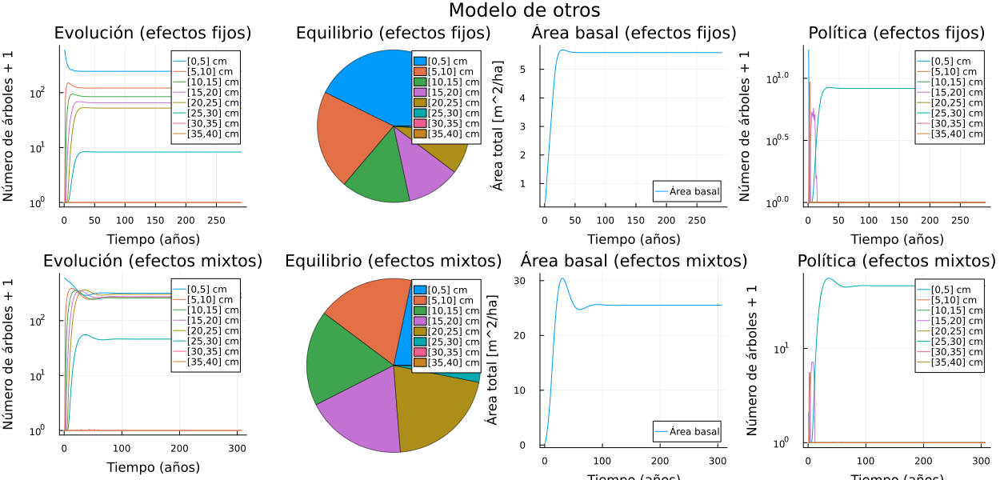

In [61]:
print("Masa total inicial = ");println(sum(Y_otros_fixed2[1,:]))
print("Masa total en equilibrio (efectos fijos) = ");println(sum(Y_otros_fixed2[end,:]))
print("Masa total en equilibrio (efectos mixtos) = ");println(sum(Y_otros_mixed2[end,:]))
print("Área basal total máxima (efectos fijos) = ");println(maximum(BA_otros_fixed2))
print("Área basal total máxima (efectos mixtos) = ");println(maximum(BA_otros_mixed2))
pf1 = plot(Y_otros_fixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Evolución (efectos fijos)", left_margin=5mm, bottom_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pf2 = pie(legends_pie, Y_otros_fixed2[end,:], title = "Equilibrio (efectos fijos)", l = 0.5)
pf3 = plot(BA_otros_fixed2, label="Área basal", title="Área basal (efectos fijos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pf4 = plot(C_otros_fixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos fijos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm1 = plot(Y_otros_mixed2 .+ 1, yaxis=:log10, label = legends, bottom_margin=5mm,
    title = "Evolución (efectos mixtos)", 
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
pm2 = pie(legends_pie, Y_otros_mixed2[end,:], title = "Equilibrio (efectos mixtos)", l = 0.5)
pm3 = plot(BA_otros_mixed2, label="Área basal", title="Área basal (efectos mixtos)", xlabel="Tiempo (años)", ylabel = "Área total [m^2/ha]")
pm4 = plot(C_otros_mixed2 .+ 1, yaxis=:log10, label = legends, 
    title = "Política (efectos mixtos)", left_margin=5mm,
    xlabel = "Tiempo (años)", ylabel = "Número de árboles + 1")
plot(pf1, pf2, pf3, pf4, pm1, pm2, pm3, pm4, layout=(2,4), size=(1250,600), 
plot_title="Modelo de otros")